# 2018 data 

Remaining things do to for code:
- For all: labels the sections by the corresponding figure in the manuscript

# (A) Import, definitions, processing to create pcamat

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import gzip
import scipy
import time

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from scipy.cluster.hierarchy import fcluster
from scipy.cluster.hierarchy import dendrogram, linkage
import openTSNE

import matplotlib.backends.backend_pdf

In [2]:

workstation=0  #[0=local/github, 162,163]
year=2018

imagedir = 'image-output/'

if workstation==162:
    %cd '/home/jdavidson/bees_sharedcodes/Bees_sharedcodes/'
elif workstation==163:
    %cd '/sharedcodes/bees/code/'    
else:
    None # for github/local, working directory is this one

import definitions_2018 as bd
if workstation==162:
    resultsdir = '/home/jdavidson/bees_data/beeresults/'
    comb_contents_dir = '/home/jdavidson/bees_data/comb-contents-images/'
elif workstation==163:
    resultsdir = '/data/beeresults/'
    comb_contents_dir = '/data/comb-contents-images/'
elif workstation==0:
    resultsdir = 'data2018/'
    comb_contents_dir = 'comb-contents2018/'     
zfilln = 2 # for file names
    
import displayfunctions as bp  # 'bee plots'
import datafunctions as dfunc
dfunc.init(bd) 
bp.init(bd)
bd.year

/home/jdavidson/bees_sharedcodes/Bees_sharedcodes/JD-2018-Github/definitions_2018.py:20: FutureWarning: The 'freq' argument in Timestamp is deprecated and will be removed in a future version.
  cohort_birthdates = np.array([pd.Timestamp(np.array(cohort_data['DOB'][cohort_data['cohort']==c])[0],freq='D') for c in cohort_colornames])


2018

# Function definitions

In [3]:
###### DISPLAY ##################################
############################################################
def histograms_per_group(n_clusters,membership,dayhist,scalesize=4,ax='',f='',coloroffset=0):
    if len(ax)==0:
        f,ax = plt.subplots(1,n_clusters,sharex=True,sharey=True)
        f.set_size_inches(scalesize*n_clusters,scalesize)
    for i in range(n_clusters):
        a = ax[i]
        clr = bp.snscolors[i+coloroffset] if coloroffset>=0 else [0,0,0]
        sel = membership == i
        histmean = np.mean(dayhist[sel],axis=0)
        a.set_title('Group '+str(i)+': '+str(np.sum(sel).astype(int))+' bee-days',fontsize=14)
        bp.showhist(histmean,ax=a,color=clr)
        bp.showframe(ax=a,color='grey')     
    return f,ax

cmapcool=plt.get_cmap('cool')

In [4]:
###### CALCULATIONS ##################################
############################################################

dottensor = lambda tensor: np.tensordot(tensor.T,tensor.T.swapaxes(0,1), axes=([1,0],[0,1])) 

def tensorfill(tensor,nanfill=0):
    tensor = tensor.copy()
    if nanfill==0:
        tensor[np.isnan(tensor)] = 0 
    elif nanfill=='rowmean':
        for j in range(tensor.shape[0]):
            for dim in range(tensor.shape[2]):
                tensor[j,np.isnan(tensor[j,:,dim]),dim] = np.nanmean(tensor[j,:,dim])
    elif nanfill=='colmean':
        for col in range(tensor.shape[1]):
            for dim in range(tensor.shape[2]):
                tensor[np.isnan(tensor[:,col,dim]),col,dim] = np.nanmean(tensor[:,col,dim])                
    else: 
        print('error - wrong value for nanfill')
    return tensor

def fill_and_tensordot(tensor,nanfill=0):
    tensor = tensorfill(tensor,nanfill)
    dot = dottensor(tensor)
    return dot-np.min(dot)  # for clustering algorithms, weights must be positive.  For ward, they can be negative, but adding a constant does not affect results


def getmembership(n_clusters,Z):
    membership_unsrt = fcluster(Z, n_clusters, criterion='maxclust')-1
    return membership_unsrt

In [5]:
def variancebycategory(inputmatrix,categories,return_details=False):
    allcats = np.unique(categories,axis=0)
    variance_per_cat = np.zeros(len(allcats))
    counts_per_cat = np.zeros(len(allcats))
    for i,cat in enumerate(allcats):
        catsel = (categories==cat)
        if len(catsel.shape)>1:
            catsel = np.all(catsel,axis=1)
        catdata = inputmatrix[catsel]
        catavg = np.mean(catdata,axis=0)
        variance_per_cat[i] = np.linalg.norm(catdata-catavg[np.newaxis,:])**2
        counts_per_cat[i] = catdata.shape[0]
    varfrac = 1 - np.sum(variance_per_cat)/(np.linalg.norm(inputmatrix)**2)
    if return_details:
        return varfrac, variance_per_cat, counts_per_cat
    else:
        return varfrac

# (A) Read in Data and make combined data matrix

In [6]:
###### READ IN DATA ########################################
############################################################

[cohort_daysalive] = pickle.load(open(resultsdir+'daysalive.pkl','rb'))
uid_daysalive = np.concatenate(cohort_daysalive)

[all_overall_comb_substrates] = pickle.load(open(resultsdir+'all_overall_comb_substrates.pkl','rb'))
all_overall_substrates5 = np.zeros((bd.numdays,5))  # just has 5
substrate_names5 = ['Honey','Brood care', 'Pollen', 'Dance floor', 'Other']
all_overall_substrates5[:,0] = all_overall_comb_substrates[:,0]  # honey
all_overall_substrates5[:,1] = all_overall_comb_substrates[:,1]+all_overall_comb_substrates[:,2]  # brood
all_overall_substrates5[:,2] = all_overall_comb_substrates[:,4]  # pollen
all_overall_substrates5[:,3] = all_overall_comb_substrates[:,5]  # dance floor
all_overall_substrates5[:,4] = 1 - np.sum(all_overall_substrates5,axis=1)


# dfday = pickle.load(gzip.open(resultsdir+'daydatamat'+'.pklz','rb'))
dfday = pd.read_csv(resultsdir+'daydatamat.csv')


# do normalizations of datamat in order to change the units
dfday['Num. observations'] = dfday['Num. observations'] /3/3600  # hours tracked
dfday['Time outside day1min'] = dfday['Time outside day1min']*24 # hours outside
dfday['Time outside day5min'] = dfday['Time outside day5min']*24 # hours outside
qs = ['Median speed', 'Speed 90th quantile', 'Dispersion (avg)','Exit distance (median)', 'Dispersion-minute avg.'] # cm
for q in qs:
    dfday[q] = dfday[q]/bd.pixels_per_cm

In [7]:
# Selecting which quantities to use
# 
normalizesubstrates = True
quantities_to_use = ['Honey', 'Brood care', 'Dance floor', 'Exit distance (median)','Num. observations',
        'Time outside day1min', 'Num. outside trips day1min','Num. dance floor visits',
        'Median speed', 'Speed circadian coeff.','Dispersion (avg)', 'Fraction squares visited']
quantities_to_use_names = ['Honey', 'Brood care', 'Dance floor', 'Exit distance','Time observed',
        'Time outside', 'Num. outside trips','Num. dance floor visits',
        'Median speed', 'Speed circadian coeff.','Dispersion', 'Fraction squares visited']
quantites_to_use_names_abbrv = ['Honey', 'Brood care', 'Dance floor', 'Exit distance','Time observed',
        'Time outside', 'Outside trips','Dance floor visits',
        'Median speed', 'Circadian coeff.','Dispersion', 'Frac. sq. visited']
quantities_to_use_names_with_units = ['Honey', 'Brood care', 'Dance floor', 'Exit distance (cm)','Time observed (hours/day)',
        'Time outside (hours/day)', 'Num. outside trips','Num. dance floor visits',
        'Median speed (cm/sec)', 'Speed circadian coeff.','Dispersion (cm)', 'Fraction squares visited']

tonorm_indices = [0,1] #['Honey', 'Brood care']

max_daynum = 50
min_num_obs = 1000
agemax_forplot = 30

In [8]:
# create pca matrix, using the above quantity specifications

daysel = (dfday['Day number']<max_daynum) & (dfday['Day number']>0)
age = dfday['Age'][daysel]

num_obs = dfday['Num. observations'][daysel]
hasnans = np.any(np.isnan(dfday[daysel][quantities_to_use]),axis=1)
age_obs_sel = (age>0) & (num_obs>min_num_obs/3/3600) & np.logical_not(hasnans)
num_removed_by_observation_threshold = np.sum ( (age>0) & (num_obs<=min_num_obs/3/3600)  )
print('num_removed_by_observation_threshold: ',num_removed_by_observation_threshold, 'or frac of ', num_removed_by_observation_threshold/np.sum(age>0))


pcamat = dfday[daysel][quantities_to_use]
for c,cnew in zip(quantities_to_use,quantities_to_use_names): # do this instead of just setting equal, because it would give an error if something doesn't match
    pcamat.rename(columns={c: cnew},inplace=True)
pcacolnames = pcamat.columns  # also see below I define "pcacolnames_label", which word wraps for use in labels
pcacolnames = quantites_to_use_names_abbrv
pcamat = np.array(pcamat)

pcamat = pcamat[age_obs_sel]
age = np.array(age[age_obs_sel])
num_obs = num_obs[age_obs_sel]
daynums = dfday['Day number'][daysel][age_obs_sel]

## get the mean for each day and normalize, if set
if normalizesubstrates:
    print('normalized substrates')
    for daynum in range(max_daynum):
        tempsel = daynums==daynum
#         daymean = np.mean(pcamat[tempsel,0:numtonorm],axis=0)
#         pcamat[tempsel,0:numtonorm] = pcamat[tempsel,0:numtonorm] - daymean[np.newaxis,:]
        for qnum in tonorm_indices:
            pcamat[tempsel,qnum] = pcamat[tempsel,qnum] - all_overall_substrates5[daynum,qnum]

        
# normalize the pcamat:
pcamat = (pcamat-np.mean(pcamat,axis=0))/np.std(pcamat,axis=0)

# save some quantities for later plotting
ids = dfday['Bee unique ID'][daysel][age_obs_sel] # this has unique values for each bee

dfday_selected = dfday[daysel][age_obs_sel].copy()

# Set some per-bee values
allbee_uids = np.unique(ids).astype(int)
allbee_cohortids = np.array([np.where([uid in b for b in bd.cohort_uids])[0][0] for uid in allbee_uids])
allbee_daysalive = uid_daysalive[allbee_uids]

# what the columns are
intnames = np.concatenate((['counts-'+str(i) for i in range(10)],['dist-'+str(i) for i in range(10)],['dspeed-'+str(i) for i in range(10*2)]))


print('shape of pcamat:',pcamat.shape)
print('number of unique bees before apply age_obs_sel:',len(np.unique(dfday['Bee unique ID'][daysel])))
print('number of unique bees included:',len(allbee_uids))
# display the matrix by showing a dataframe
pd.set_option('display.max_columns', None)
print('\nNormalized data matrix:')
pd.DataFrame(pcamat[0:2],columns=pcacolnames)

num_removed_by_observation_threshold:  7201 or frac of  0.11842191816866202
normalized substrates
shape of pcamat: (53032, 12)
number of unique bees before apply age_obs_sel: 4229
number of unique bees included: 4193

Normalized data matrix:


,Honey,Brood care,Dance floor,Exit distance,Time observed,Time outside,Outside trips,Dance floor visits,Median speed,Circadian coeff.,Dispersion,Frac. sq. visited
0,0.193840,-1.041836,-0.750360,-0.491084,-0.881605,-0.555657,-0.638222,-0.737969,0.357107,2.399690,-1.604128,-1.283511
1,-0.713553,0.658839,0.613563,-0.236430,-0.859544,-0.555657,-0.638222,-0.591452,1.570036,-0.782872,-1.241181,-1.258615


In [9]:
# load histograms
savefile = resultsdir+'dfxy_day.pklz'
dfxyday = pickle.load(gzip.open(savefile,'rb'))
dfxyday = dfxyday[(dfxyday['Day number']>=1) & (dfxyday['Day number']<max_daynum)]
dfxyday.reset_index(level=0, inplace=True)

correct_order = np.all(dfday[daysel]['Bee unique ID'].values == dfxyday['Bee unique ID'].values)
print('Is the xy df in the right order?: ',correct_order)

dayhist = np.array([dfunc.flat_to_hist(r) for r in dfxyday[age_obs_sel.values].values[:,2:]])
print('loaded histograms')

Is the xy df in the right order?:  True
loaded histograms


# (B) Cohort-distribution plots (Fig 2, S2)

In [55]:
frac_threshold = 0.05  # do not calculate median and quantiles unless at least this fraction of the cohort was observed that day

# put in the format:  cohort, day, quantity
cohort_perday_hists_indiv = np.zeros((bd.numcohorts,max_daynum,len(quantities_to_use),3))
cohort_perday_hists_indiv_normsubstratessub = np.zeros((bd.numcohorts,max_daynum,5,3))
cohort_perday_hists_indiv_normsubstratesdiv = np.zeros((bd.numcohorts,max_daynum,5,3))
all_fracs = np.zeros((bd.numcohorts,max_daynum))   # fraction of cohort bees observed on each day, with number of observations > min (note, if obs<min, then the bee is not included in data matrix anyways)
for cnum in range(1,bd.numcohorts):
    seldata = dfday_selected[dfday_selected['Cohort ID']==cnum]
    for d in range(max_daynum):
        daysel = seldata['Day number']==d
        frac = np.sum(daysel)/len(bd.cohort_tagids[cnum])
        all_fracs[cnum,d] = frac
        if frac>=frac_threshold:
            cohort_perday_hists_indiv[cnum,d] = np.nanquantile(seldata[daysel][quantities_to_use],[0.25,0.5,0.75],axis=0).T
        for snum in range(5):
            cohort_perday_hists_indiv_normsubstratessub[cnum,d,snum] = np.nanquantile(seldata[daysel][substrate_names5[snum]] - all_overall_substrates5[d,snum],[0.25,0.5,0.75])
            cohort_perday_hists_indiv_normsubstratesdiv[cnum,d,snum] = np.nanquantile(seldata[daysel][substrate_names5[snum]]/ all_overall_substrates5[d,snum],[0.25,0.5,0.75])

/home/jdavidson/miniconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1366: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


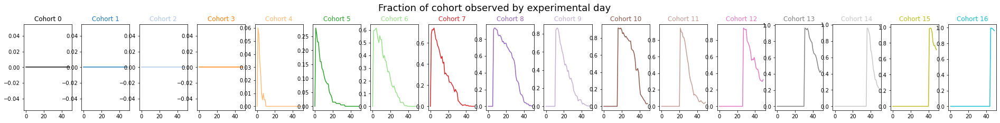

In [56]:
f,ax = plt.subplots(1,bd.numcohorts,sharex=True)
f.set_size_inches(33,3)
for cnum in range(bd.numcohorts):
    ax[cnum].plot(all_fracs[cnum],c=bd.cohort_colors[cnum])
    ax[cnum].set_title('Cohort '+str(cnum),c=bd.cohort_colors[cnum])
plt.suptitle('Fraction of cohort observed by experimental day', fontsize=18,y=1.06)
plt.show()

In [57]:
def plotalphaline(x,y,c,alphavals,ax='',zorder=-1,linewidth=1,dxfrac=1,skip=1):
    if ax=='':
        f,ax = plt.subplots(1,1)
    for k in range(0,len(x)-skip,skip):
        dx = x[k+skip]-x[k]
        dy = y[k+skip]-y[k]
        space = dxfrac*dx
        yspace = dxfrac*dy
#         if yspace>space:
#             dxfrac = space/dy
        alpha_to_plot = np.mean(alphavals[k:k+1+skip])
        alpha_to_plot = 0 if (alpha_to_plot<frac_threshold) else alpha_to_plot
        ax.plot([x[k],x[k]+dxfrac*dx],[y[k],y[k]+dxfrac*dy],c=c,alpha=alpha_to_plot,zorder=zorder,linewidth=linewidth,rasterized=True)
        
def plotalphafill(x,y1,y2,c,alphavals,ax='',zorder=-1,dxfrac=1,skip=1):
    if ax=='':
        f,ax = plt.subplots(1,1)
    for k in range(0,len(x)-skip,skip):
        dx = x[k+skip]-x[k]
        dy1 = y1[k+skip]-y1[k]
        dy2 = y2[k+skip]-y2[k]        
        ax.fill_between([x[k],x[k]+dxfrac*dx],[y1[k],y1[k]+dxfrac*dy1],[y2[k],y2[k]+dxfrac*dy2],color=c,alpha=np.mean(alphavals[k:k+1+skip]),zorder=zorder,linewidth=0,rasterized=True)    

def plot_cohorts_alpha_fill(a,data_toplot,xvals='age'):
    
    for cc in range(len(bd.cohort_birthdates)-1):
        cnum = cc+1
        firstbday = np.sort(bd.cohort_birthdates)[1]
        bdayrange = np.max(bd.cohort_birthdates) - firstbday

        agetemp = (bd.alldaytimestamps[0:max_daynum] - bd.cohort_birthdates[cnum]).astype('timedelta64[D]')
        rel_bday = (bd.cohort_birthdates[cnum] - firstbday).days / bdayrange.days
        tpsel = agetemp>0        
        
        color=bd.cohort_colors[cnum]
    
        # for median + IQR
        fillalphamult = 0.2
        q1, median, q2 = data_toplot[cnum,tpsel].T
        # if these are all equal, then its an artifact, set to nan so they dont get plotted
        toremove = (q1==median)&(median==q2)
        q1[toremove], median[toremove], q2[toremove] = np.nan, np.nan, np.nan
        
        if xvals=='age':
            xtp = agetemp[tpsel]
        else:
            xtp = np.arange(max_daynum)[tpsel]
        
        plotalphaline(xtp,median,color,all_fracs[cc,tpsel],ax=a,linewidth=1.5,zorder=1,dxfrac=0.9)
        plotalphafill(xtp,q1,q2,color,fillalphamult*all_fracs[cc,tpsel],ax=a,dxfrac=1.0)
        
        # for the legend
        clabel = bd.cohort_names[cnum]+': ' + bp.showmonthday(bd.cohort_birthdates[cnum])
        a.plot([0],[0],alpha=1,c=color,label = clabel,linewidth=2)    


        
def setdateticks(a,xrange='max'):
    if xrange=='max':
        xt = np.arange(0,max_daynum+1,11)
        a.set_xlim([0,max_daynum])
    else:
        xt = np.arange(0,xrange+1,10)
        a.set_xlim([0,xrange])
    a.tick_params(labelsize=14)
    a.set_xticks(xt)
    a.set_xticklabels([bp.showmonthday(d) for d in bd.alldaytimestamps[xt]])
    a.set_xlabel('Date (month-day)',fontsize=16)

    
def setageticks(a,xrange=35):
    xt = np.arange(0,xrange+1,10)
    a.tick_params(labelsize=14)
    a.set_xticks(xt)
    a.set_xticklabels(xt)
    a.set_xlabel('Age (days)',fontsize=16)
    a.set_xlim([0,xrange])  

## Substrate use over time

In [59]:
savefigures = False
savefile = imagedir+'/generaltrends-cohorts.pdf'
if savefigures:
    pdf = matplotlib.backends.backend_pdf.PdfPages(savefile)
    print('opened file at', savefile)

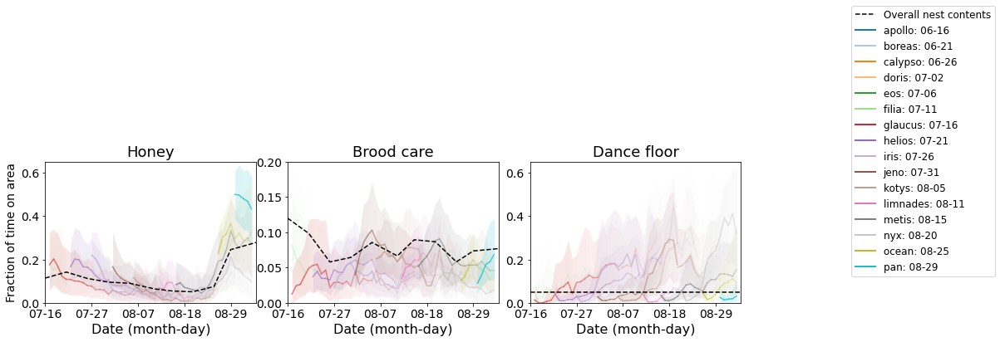

In [22]:
sameaxis=False
xrange='max'

toshow = ['Honey', 'Brood care', 'Dance floor']

f,ax = plt.subplots(1,len(toshow),sharex=True,sharey=(True if sameaxis else False))
f.set_size_inches(5*len(toshow),5/1.6)
tpx = np.arange(0,bd.numdays)

for i,sname in enumerate(toshow):
    
    a = ax[i]
    
    sub_ind = np.where(np.array(substrate_names5)==sname)[0][0]
    a.plot(tpx,all_overall_substrates5[:,sub_ind],'k--',label='Overall nest contents',zorder=2)    
    met_ind = np.where(np.array(quantities_to_use)==sname)[0][0]
    data_toplot = cohort_perday_hists_indiv[:,:,met_ind,:]
    plot_cohorts_alpha_fill(a,data_toplot,xvals='days')
    title = quantities_to_use_names[met_ind]
    a.set_title(title,fontsize=18)
    

ax[0].set_ylabel('Fraction of time on area',fontsize=14)
[setdateticks(a,xrange) for a in ax]
[a.set_ylim(bottom=0) for a in ax]  
ax[1].set_ylim(top=0.2)
ax[0].set_ylim(top=0.65)
ax[2].set_ylim(top=0.65)
plt.subplots_adjust(wspace=0.15)
ax[-1].legend(fontsize=12,bbox_to_anchor=(1.5,0.15))
pdf.savefig(f) if savefigures else None
plt.show()

## Substrate use and other metrics with age

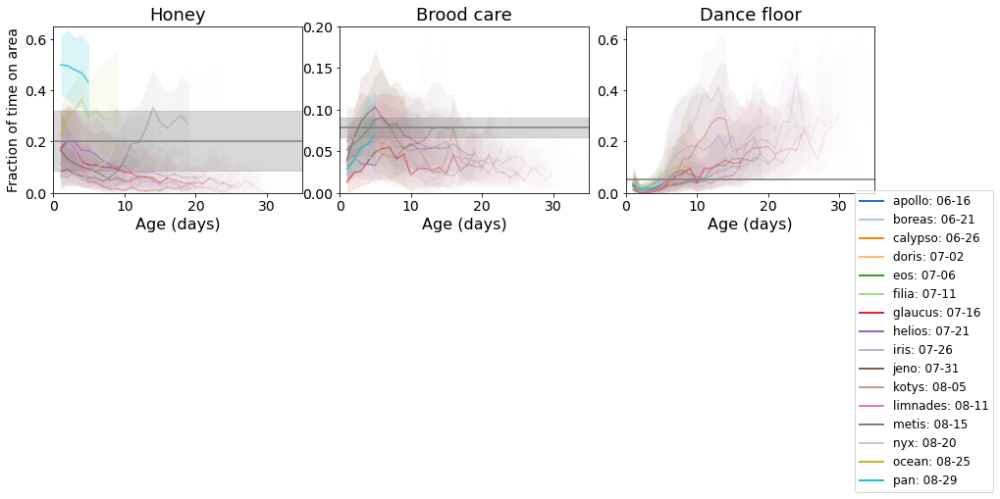

In [23]:
### Non-normalized substrates
sameaxis=False

xrange=35

toshow = ['Honey', 'Brood care', 'Dance floor']

f,ax = plt.subplots(1,len(toshow),sharex=True,sharey=(True if sameaxis else False))
f.set_size_inches(5*len(toshow),5/1.6)
tpx = np.arange(0,bd.numdays)

for i,sname in enumerate(toshow):
    a = ax[i]
    sub_ind = np.where(np.array(substrate_names5)==sname)[0][0]
    met_ind = np.where(np.array(quantities_to_use)==sname)[0][0]

    # overall contents 
    mean_contents = np.mean(all_overall_substrates5[:,sub_ind])
    std_contents = np.std(all_overall_substrates5[:,sub_ind])

    a.fill_between(tpx,(mean_contents+std_contents)*np.ones(len(tpx)),(mean_contents-std_contents)*np.ones(len(tpx)),color='grey',alpha=0.3)
    a.plot(tpx,(mean_contents)*np.ones(len(tpx)),c='grey')

    data_toplot = cohort_perday_hists_indiv[:,:,met_ind,:]
    plot_cohorts_alpha_fill(a,data_toplot,xvals='age')
    
    title = quantities_to_use_names[met_ind]
    a.set_title(title,fontsize=18)    
    setageticks(a,xrange)

ax[-1].legend(fontsize=12,bbox_to_anchor=(1.5, 0.05))
ax[0].set_ylabel('Fraction of time on area',fontsize=14)

[a.set_ylim(bottom=0) for a in ax]  
ax[1].set_ylim(top=0.2)
ax[0].set_ylim(top=0.65)
ax[2].set_ylim(top=0.65)

plt.subplots_adjust(wspace=0.15)
pdf.savefig(f) if savefigures else None
plt.show()

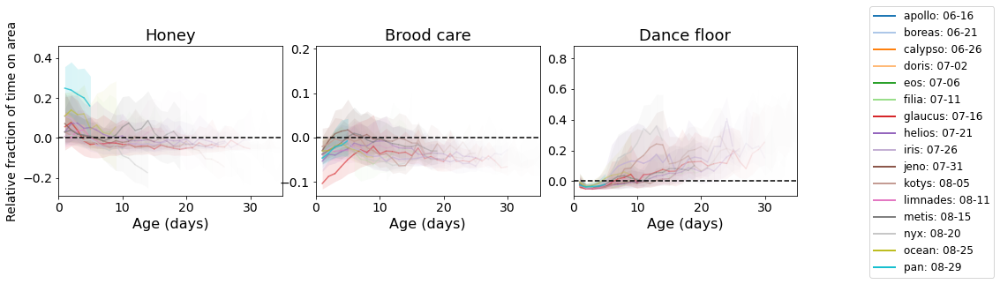

In [24]:
### Normalized substrates
sameaxis=False

xrange=35

toshow = ['Honey', 'Brood care', 'Dance floor']

f,ax = plt.subplots(1,len(toshow),sharex=True,sharey=(True if sameaxis else False))
f.set_size_inches(5*len(toshow),5/1.6)
tpx = np.arange(0,bd.numdays)

for i,sname in enumerate(toshow):
    a = ax[i]
    sub_ind = np.where(np.array(substrate_names5)==sname)[0][0]
    met_ind = np.where(np.array(quantities_to_use)==sname)[0][0]

    data_toplot = cohort_perday_hists_indiv_normsubstratessub[:,:,sub_ind,:]
    plot_cohorts_alpha_fill(a,data_toplot,xvals='age')
    
    a.axhline(0,color='k',linestyle='--',zorder=2)  
    title = quantities_to_use_names[met_ind]
    a.set_title(title,fontsize=18)    

ax[0].set_ylabel('Relative fraction of time on area',fontsize=14)    
ax[-1].legend(fontsize=12,bbox_to_anchor=(1.3, 1.3))
[setageticks(a,xrange) for a in ax]
plt.subplots_adjust(wspace=0.15)
pdf.savefig(f) if savefigures else None
plt.show()

In [17]:
### Other metrics with age
toshow = quantities_to_use[3:]
print(toshow)

['Exit distance (median)', 'Num. observations', 'Time outside day1min', 'Num. outside trips day1min', 'Num. dance floor visits', 'Median speed', 'Speed circadian coeff.', 'Dispersion (avg)', 'Fraction squares visited']


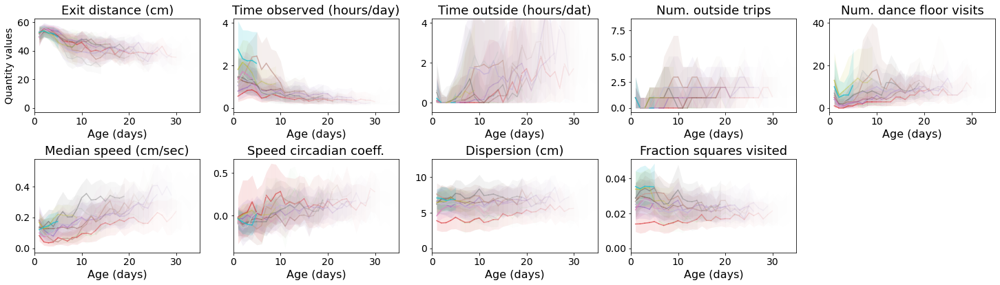

In [26]:

numrows=2
xrange=35

numcols = np.ceil(len(toshow)/numrows).astype(int)
f,ax = plt.subplots(numrows,numcols,sharex='row')
f.set_size_inches(5*numcols,5/1.6*numrows)

for i,sname in enumerate(toshow):
    r,c = np.divmod(i,numcols)
    a = ax[r,c]
    met_ind = np.where(np.array(quantities_to_use)==sname)[0][0]
    
    data_toplot = cohort_perday_hists_indiv[:,:,met_ind,:]
    plot_cohorts_alpha_fill(a,data_toplot,xvals='age')
    
    title = quantities_to_use_names_with_units[met_ind]
    a.set_title(title,fontsize=18)    
    setageticks(a,xrange)

# legend and formatting

# specific formatting
ax[0,0].set_ylabel('Quantity values',fontsize=14)
# [a.set_ylim(bottom=0) for a in ax[[0,1,3]]]
# ax[2].set_ylim(bottom=-0.4)
# ax[3].set_ylim([1,11])
ax[0,1].set_ylim(top=4.2)
ax[0,2].set_ylim(top=4.2)
ax[-1,-1].axis('off')
plt.subplots_adjust(wspace=0.2,hspace=0.5)
# ax[0,-1].legend(fontsize=12,bbox_to_anchor=(1.6, 0.15))


pdf.savefig(f) if savefigures else None
plt.show()

## Substrate histograms

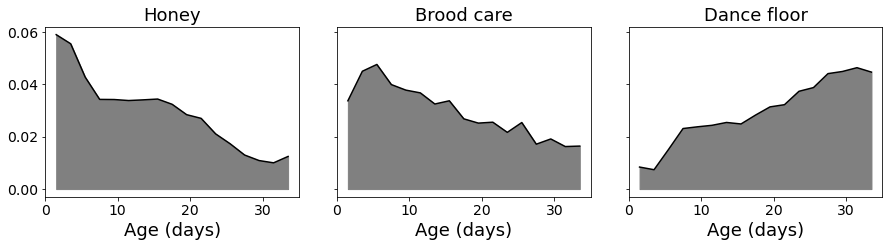

In [27]:
toshow = ['Honey', 'Brood care', 'Dance floor']

basesize=2.5
numrows=1
perrow = np.ceil((len(toshow))/numrows).astype(int)
f,ax = plt.subplots(numrows,perrow,sharex=True,sharey=True)
f.set_size_inches(5*perrow,5/1.6)

if numrows==1:
    ax = np.array([ax])    

firstbday = np.sort(bd.cohort_birthdates)[1]
bdayrange = np.max(bd.cohort_birthdates) - firstbday    

agemax = 35
ageedges = np.arange(1,agemax+2,2)-0.5  # age starts at 1
ageedges = ageedges[::1]
agetp = (ageedges[0:-1]+ageedges[1:])/2
dage = ageedges[1]-ageedges[0]

# create data structure for saving binned age quantities
qagebinned = np.zeros((len(ageedges)-1,len(toshow)))
for i,sname in enumerate(toshow):
    q = dfday_selected[sname]
    qagebinned[:,i] = scipy.stats.binned_statistic(age,q,statistic='sum',bins=ageedges)[0]
# normalize by total number of observations for that age group
totalobs = np.sum(qagebinned,axis=1)
qagebinned = qagebinned/totalobs[:,np.newaxis]
# and make it into a probability density function
qagebinned = qagebinned/(np.sum(qagebinned,axis=0)[np.newaxis,:]*dage)


for i,sname in enumerate(toshow):    
    a = ax[np.floor((i)/perrow).astype(int),np.mod(i,perrow)]    
    met_ind = np.where(np.array(quantities_to_use)==sname)[0][0]

    # plot combined distribution, all cohorts
    a.plot(agetp,qagebinned[:,i],'k-',zorder=10,label='Combined distribution')
    a.fill_between(agetp,0,qagebinned[:,i],color='grey')

    a.tick_params(labelsize=16)
    title = quantities_to_use_names[met_ind]
    a.set_title(title,fontsize=18)    
    setageticks(a,xrange)
    a.set_xlabel('Age (days)',fontsize=18)

plt.subplots_adjust(wspace=0.1,hspace=0.1)
ax[0,0].set_xlim([0,agemax])        

plt.subplots_adjust(wspace=0.15)
pdf.savefig(f) if savefigures else None
# [plt.savefig('../image-output/substratehistograms.'+ext) for ext in ['svg','pdf','png'] ]
plt.show()


In [28]:
pdf.close() if savefigures else None
savefigures=False

## Quantify within-cohort variance

In [173]:
cohortids = dfday_selected['Cohort ID']

In [178]:
print('Variance explained by cohorts:',variancebycategory(pcamat,cohortids))

print('Variance explained by ages:',variancebycategory(pcamat,age))

print('Variance explained by cohorts and ages:',variancebycategory(pcamat,np.array([cohortids,age]).T))

Variance explained by cohorts: 0.051554213514158564
Variance explained by ages: 0.09198730949604139
Variance explained by cohorts and ages: 0.16956350189859948


In [199]:
# by metric, considering cohortid and age
categories = np.array([cohortids,age]).T
n = len(pcacolnames)
# use the 'mod' as a quick way to select all for the last one
explained_ca = np.round([variancebycategory(pcamat[:,np.mod(i,n):i+1],categories) for i in range(n+1)],3)*100
explained_a = np.round([variancebycategory(pcamat[:,np.mod(i,n):i+1],age) for i in range(n+1)],3)*100
explained_c = np.round([variancebycategory(pcamat[:,np.mod(i,n):i+1],cohortids) for i in range(n+1)],3)*100
dispdf = pd.DataFrame(np.array([np.append(pcacolnames,"ALL METRICS"),explained_ca,explained_a,explained_c]).T,columns=['Metric','Vfrac: c&a','Vfrac: age','Vfrac: cohort'])
dispdf


,Metric,Vfrac: c&a,Vfrac: age,Vfrac: cohort
0,Honey,11.0,3.9,5.8
1,Brood care,7.7,2.9,1.7
2,Dance floor,26.6,19.3,2.7
3,Exit distance,28.7,23.1,2.6
4,Time observed,27.1,17.1,14.2
5,Time outside,15.3,10.6,2.1
6,Num. outside trips,12.6,5.9,2.1
7,Num. dance floor visits,12.7,2.7,4.6
8,Median speed,27.0,14.4,6.8
9,Speed circadian coeff.,10.4,6.1,2.4


In [201]:
print(dispdf.to_latex(index=False))

\begin{tabular}{llll}
\toprule
                  Metric & Vfrac: c\&a & Vfrac: age & Vfrac: cohort \\
\midrule
                   Honey &       11.0 &        3.9 &           5.8 \\
              Brood care &        7.7 &        2.9 &           1.7 \\
             Dance floor &       26.6 &       19.3 &           2.7 \\
           Exit distance &       28.7 &       23.1 &           2.6 \\
           Time observed &       27.1 &       17.1 &          14.2 \\
            Time outside &       15.3 &       10.6 &           2.1 \\
      Num. outside trips &       12.6 &        5.9 &           2.1 \\
 Num. dance floor visits &       12.7 &        2.7 &           4.6 \\
            Median speed &       27.0 &       14.4 &           6.8 \\
  Speed circadian coeff. &       10.4 &        6.1 &           2.4 \\
              Dispersion &        9.9 &        0.6 &           6.8 \\
Fraction squares visited &       14.5 &        3.7 &          10.1 \\
             ALL METRICS &       17.0 &        9.

# (C) Bee-day (Fig 3, S3)

In [11]:
savefigures = False
if savefigures:
    pdffile = imagedir+'beedayplots.pdf'
    pdf = matplotlib.backends.backend_pdf.PdfPages(pdffile)
    print('opened file at', pdffile)

## PCA

sum of explained variance:  1.0


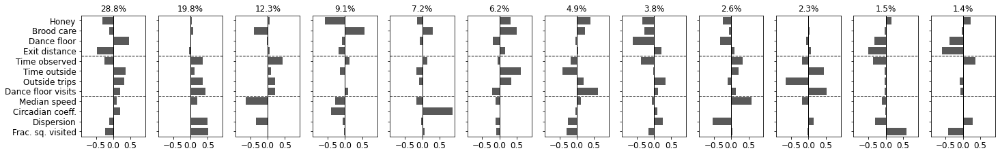

age corr (spearman) of each component:  [ 0.493  0.024 -0.295 -0.16   0.007 -0.029  0.051 -0.029 -0.018 -0.012
  0.11   0.034]


In [12]:
numev=len(pcacolnames)

pca = PCA(n_components=numev).fit(pcamat)
vh = pca.components_
u = pca.transform(pcamat)

pcavar = pca.explained_variance_ratio_
print('sum of explained variance: ',np.sum(pcavar))

numev_toshow=numev
f,ax = plt.subplots(1,numev_toshow,sharex=True,sharey=True)
scalesize=1
f.set_size_inches(2*numev_toshow*scalesize,3/11*len(pcacolnames)*scalesize)
bp.pcacomponentplots(ax,vh[:numev_toshow],pcacolnames)
for j in range(numev_toshow):
    a = ax[j]
    a.set_title(str(round(pcavar[j]*100,1))+'%')
    [a.axhline(div,c='k',linestyle='--',linewidth=1) for div in [3.5,7.5]]  # for three "categories" of metrics
pdf.savefig(f) if savefigures else None    
plt.show()

agecorr = [scipy.stats.spearmanr(age,u[:,i])[0] for i in range(numev)]
print('age corr (spearman) of each component: ',np.round(agecorr,3))

In [13]:
# amount of variance explained in the different quantities
numpca_for_prediction = 3
pcapredict = np.dot(u[:,0:numpca_for_prediction],vh[0:numpca_for_prediction])
print('variance explained of first '+str(numpca_for_prediction)+':' , 1-np.linalg.norm(pcamat - pcapredict)**2/np.linalg.norm(pcamat)**2)
varexp = [np.round(1-np.linalg.norm(pcamat[:,i] - pcapredict[:,i])**2/np.linalg.norm(pcamat[:,i])**2,3) for i in range(pcamat.shape[1])]
pca0corr = [np.round(scipy.stats.pearsonr(u[:,0],p)[0],3) for p in pcamat.T]
pca1corr = [np.round(scipy.stats.pearsonr(u[:,1],p)[0],3) for p in pcamat.T]
pd.DataFrame(np.array([pcacolnames,varexp,pca0corr,pca1corr]).T,columns=['Name','Var explained','Correlation with PCA 0','Correlation with PCA 1'])

variance explained of first 3: 0.6089537652681212


,Name,Var explained,Correlation with PCA 0,Correlation with PCA 1
0,Honey,0.343,-0.577,0.06
1,Brood care,0.305,-0.218,0.107
2,Dance floor,0.708,0.84,0.042
3,Exit distance,0.804,-0.892,-0.05
4,Time observed,0.786,-0.481,0.54
5,Time outside,0.494,0.672,0.172
6,Outside trips,0.71,0.583,0.544
7,Dance floor visits,0.654,0.385,0.659
8,Median speed,0.747,0.201,0.307
9,Circadian coeff.,0.131,0.361,-0.011


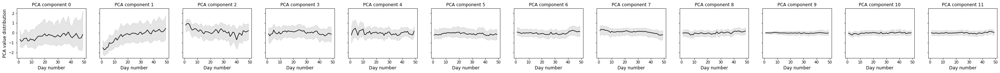

In [14]:
# Plot PCA distributions over time
daybins = np.arange(max_daynum+1)-0.5

pca_over_time = np.zeros((max_daynum,numev,3))

for enum in range(numev):
    for j,qvalue in enumerate([0.25,0.5,0.75]):
        pca_over_time[:,enum,j] = scipy.stats.binned_statistic(daynums,u[:,enum],bins=daybins,statistic=(lambda x: np.quantile(x,qvalue)))[0]


f,ax = plt.subplots(1,numev,sharex=True,sharey=True)
f.set_size_inches(4*numev,2.5)

tpx = np.arange(max_daynum)
for enum in range(numev):
    a = ax[enum]
    a.plot(tpx,pca_over_time[:,enum,1],color='k')
    a.fill_between(tpx,pca_over_time[:,enum,0],pca_over_time[:,enum,2],color='k',alpha=0.1)
    a.set_title('PCA component '+str(enum),fontsize=12)

ax[0].set_ylabel('PCA value distribution',fontsize=12)
[a.set_xlabel('Day number',fontsize=12) for a in ax]
pdf.savefig(f) if savefigures else None
plt.show()

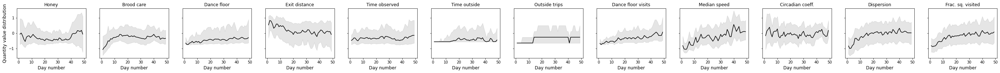

In [15]:
# Plot quantity distributions over time
daybins = np.arange(max_daynum+1)-0.5

quantities_over_time = np.zeros((max_daynum,pcamat.shape[1],3))

for k in range(pcamat.shape[1]):
    for j,qvalue in enumerate([0.25,0.5,0.75]):
        quantities_over_time[:,k,j] = scipy.stats.binned_statistic(daynums,pcamat[:,k],bins=daybins,statistic=(lambda x: np.quantile(x,qvalue)))[0]


f,ax = plt.subplots(1,pcamat.shape[1],sharex=True,sharey=True)
f.set_size_inches(4*pcamat.shape[1],2.5)

tpx = np.arange(max_daynum)
for k in range(pcamat.shape[1]):
    a = ax[k]
    a.plot(tpx,quantities_over_time[:,k,1],color='k')
    a.fill_between(tpx,quantities_over_time[:,k,0],quantities_over_time[:,k,2],color='k',alpha=0.1)
    a.set_title(pcacolnames[k],fontsize=12)

ax[0].set_ylabel('Quantity value distribution',fontsize=12)
[a.set_xlabel('Day number',fontsize=12) for a in ax]
pdf.savefig(f) if savefigures else None
plt.show()

In [16]:
#  Correlations
numq = pcamat.shape[1]
pcacorrmat = np.zeros((numq+1,numq+1))
for q0 in range(numq+1):
    for q1 in range(q0+1,numq+1):
        if q0==0:  # then do age
            ctemp = scipy.stats.pearsonr(age,pcamat[:,q1-1])[0]
        else:
            ctemp = scipy.stats.pearsonr(pcamat[:,q0-1],pcamat[:,q1-1])[0]
        pcacorrmat[q0,q1] = ctemp
        pcacorrmat[q1,q0] = ctemp

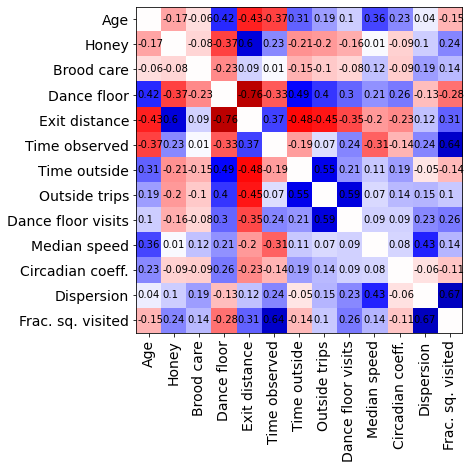

In [17]:
f,ax = plt.subplots(1,1)
f.set_size_inches(6,6)
ax.imshow(-pcacorrmat,vmin=-1,vmax=1,cmap='seismic')
ax.set_xticks(range(numq+1))
ax.set_xticklabels(np.concatenate((['Age'],pcacolnames)),rotation=90,fontsize=14)
ax.set_yticks(range(numq+1))
ax.set_yticklabels(np.concatenate((['Age'],pcacolnames)),fontsize=14)
for q0 in range(numq+1):
    for q1 in range(numq+1):
        if not (q0==q1):
            ax.annotate(np.round(pcacorrmat[q0,q1],2),(q1-0.45,q0+0.1))
            
pdf.savefig(f) if savefigures else None
plt.show()            

## Clustering and embedding - calculate

In [19]:
recalc_and_save = False

# main paper uses i=1. Need to re-calculate to make plot for Bee-life metrics
i=1
beedayresultsname = str(i)
random_state = 41+1
which_tsne = 'opentsne-train'
savefile = 'beeday-'+which_tsne+'-'+beedayresultsname+'.pklz'

if recalc_and_save:
    # tutorial from:  https://joernhees.de/blog/2015/08/26/scipy-hierarchical-clustering-and-dendrogram-tutorial/
    # Hierarchical clustering
    start = time.time()
    Z = linkage(pcamat,method='ward')
    print('Clustering done in ',time.time()-start,' seconds')

    time_start = time.time()
    if which_tsne=='sklearn':
        tsne = TSNE(n_components=2, verbose=0, perplexity=30, n_iter=1000, metric='euclidean',init=u[:,0:2],random_state=random_state)
        tsne_result = tsne.fit_transform(pcamat)
    elif which_tsne=='opentsne':
        tsne = openTSNE.TSNE(n_components=2,
            initialization="pca",
            n_jobs=4,
            random_state=random_state,
            perplexity=30, n_iter=1000, metric='euclidean'
        )
        tsne_train_result = tsne.fit(pcamat)   
        def get_tsne_embedding(pcamat_input):
            return tsne_train_result.transform(pcamat_input)
        tsne_result = get_tsne_embedding(pcamat)    
    # opentsne- advanced implementation, with refinement. This is better if will use for embedding other data
    # from https://opentsne.readthedocs.io/en/latest/examples/02_advanced_usage/02_advanced_usage.html
    elif which_tsne=='opentsne-train':

        time_start = time.time()
        affinities_train = openTSNE.affinity.PerplexityBasedNN(pcamat,perplexity=30,metric="euclidean",n_jobs=8,random_state=random_state)
        init_train = openTSNE.initialization.pca(pcamat, random_state=random_state)

        embedding_train = openTSNE.TSNEEmbedding(init_train,affinities_train,negative_gradient_method="fft",n_jobs=8)#,callbacks=openTSNE.callbacks.ErrorLogger())
        embedding_train_1 = embedding_train.optimize(n_iter=250, exaggeration=12, momentum=0.5)
        tsne_train_result = embedding_train_1.optimize(n_iter=750, momentum=0.8)
        print ('t-SNE embedding done! Time elapsed: {} seconds'.format(time.time()-time_start))
        time_start = time.time()
        def get_tsne_embedding(pcamat_input):
            embedding_test = tsne_train_result.prepare_partial(pcamat_input,    initialization="median",    k=25,    perplexity=5)
            # optimized embedding
            embedding_test_opt = embedding_test.optimize(n_iter=100,learning_rate=1,exaggeration=2,momentum=0)
            return embedding_test_opt
        tsne_result = get_tsne_embedding(pcamat)
    # save result to file
    pickle.dump([Z,tsne_result,which_tsne,random_state],gzip.open(savefile,'wb'))
    print ('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))
    
else:
    [Z,tsne_result,which_tsne,random_state] = pickle.load(gzip.open(savefile,'rb'))    

## Clustering plots

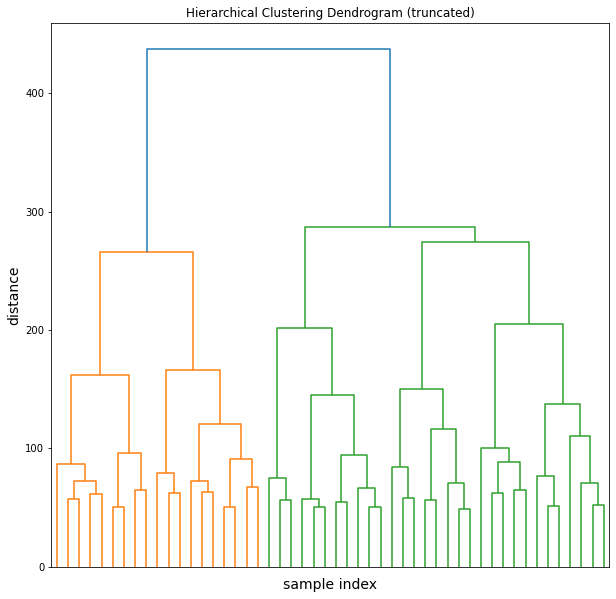

In [66]:
f,ax = plt.subplots(1,1)
f.set_size_inches(10,10)
plt.title('Hierarchical Clustering Dendrogram (truncated)')
plt.xlabel('sample index',fontsize=14)
plt.ylabel('distance',fontsize=14)
dendrogram(
    Z,
    truncate_mode='lastp',  # show only the last p merged clusters
    p=50,  # show only the last p merged clusters
    show_leaf_counts=False,  # otherwise numbers in brackets are counts
    leaf_rotation=90.,
    leaf_font_size=12.,
    show_contracted=False,  # to get a distribution impression in truncated branches
)
pdf.savefig(f) if savefigures else None
plt.show()

In [45]:
# number of clusters to show in the plots below
nc_toshow = [5]

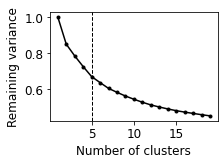

In [46]:
# Remaining variance
nc_toplot = np.arange(1,20)
vf = np.zeros_like(nc_toplot).astype(float)
for i,n_clusters in enumerate(nc_toplot):
    membership = getmembership(n_clusters,Z)
    vf[i] = variancebycategory(pcamat,membership)
    
f,ax = plt.subplots(1,1)
f.set_size_inches(3,2)
ax.plot(nc_toplot,1-vf,marker='.',c='k')
# ax.plot(nc_toplot,avgvar_pairwise,marker='.',c='b')
ax.tick_params(labelsize=12)
ax.set_ylabel('Remaining variance',fontsize=12)
ax.set_xlabel('Number of clusters',fontsize=12)
ax.axvline(nc_toshow[0],color='k',linewidth=1,linestyle='--')
# plt.savefig('../image-output/temp-bdvar.pdf')
pdf.savefig(f) if savefigures else None
plt.show()    

In [196]:
# by metric, considering diff amounts of clusters
nclusters_tocompare = [2,3,4,5,10]
# use the 'mod' as a quick way to select all for the last one
explained_1 = np.round([variancebycategory(pcamat[:,np.mod(i,n):i+1],getmembership(nclusters_tocompare[0],Z)) for i in range(n+1)],3)
explained_2 = np.round([variancebycategory(pcamat[:,np.mod(i,n):i+1],getmembership(nclusters_tocompare[1],Z)) for i in range(n+1)],3)
explained_3 = np.round([variancebycategory(pcamat[:,np.mod(i,n):i+1],getmembership(nclusters_tocompare[2],Z)) for i in range(n+1)],3)
pd.DataFrame(np.array([np.append(pcacolnames,"ALL METRICS"),explained_1,explained_2,explained_3]).T,
             columns=['Metric','Vfrac: '+str(nclusters_tocompare[0]),
                     'Vfrac: '+str(nclusters_tocompare[1]),'Vfrac: '+str(nclusters_tocompare[2])])


,Metric,Vfrac: 2,Vfrac: 3,Vfrac: 10
0,Honey,0.089,0.27,0.478
1,Brood care,0.041,0.076,0.509
2,Dance floor,0.388,0.409,0.58
3,Exit distance,0.354,0.46,0.532
4,Time observed,0.009,0.258,0.421
5,Time outside,0.319,0.32,0.571
6,Num. outside trips,0.324,0.324,0.543
7,Num. dance floor visits,0.235,0.235,0.455
8,Median speed,0.011,0.082,0.362
9,Speed circadian coeff.,0.023,0.045,0.272


## tSNE embeddings

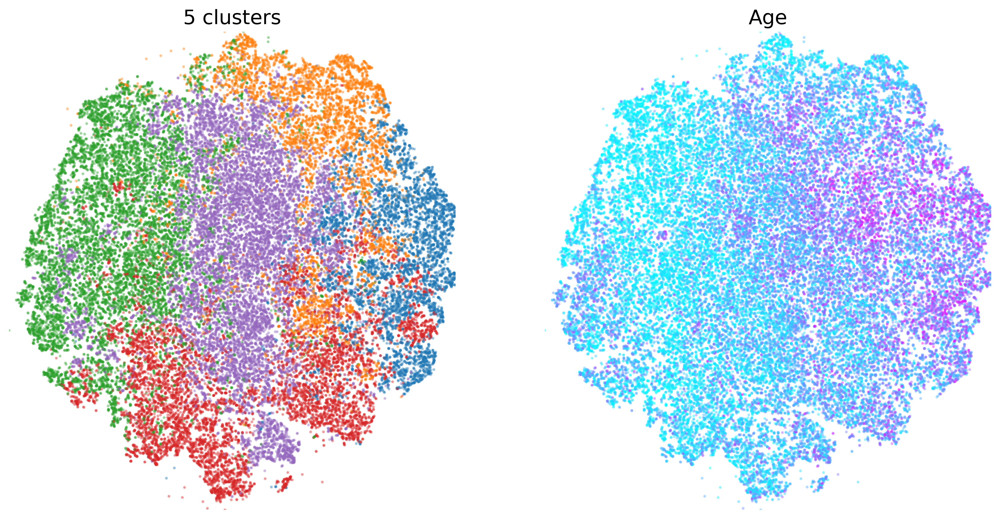

In [61]:
basesize=7
f,ax = plt.subplots(1,len(nc_toshow)+1,sharex=True,sharey=True)
f.set_size_inches(basesize*len(ax),basesize)
f.set_dpi(300) if savefigures else None
for j, n_clusters in enumerate(nc_toshow):
    membership = getmembership(n_clusters,Z)
    bp.plot_tsne_withcolors(ax[j],tsne_result,membership,str(n_clusters)+' clusters',plotskip=1,colortype='cat',s=2,alphaval=0.3)
agetp = age.copy()
agetp[agetp>=agemax_forplot] = agemax_forplot
bp.plot_tsne_withcolors(ax[-1],tsne_result,agetp,'Age',plotskip=1,colortype='scalar',s=2,alphaval=0.3,qmin=0,qmax=1)    
[a.axis('off') for a in ax]
pdf.savefig(f) if savefigures else None
# plt.savefig('../image-output/tsne.pdf',dpi=300)
plt.show()

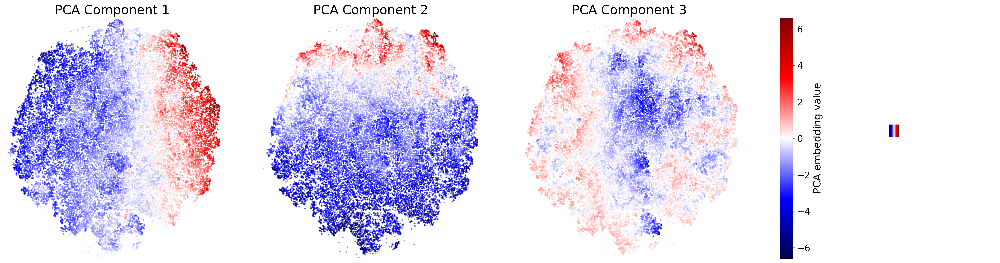

In [62]:
basesize=7
numpca_toshow = 3
f,ax = plt.subplots(1,numpca_toshow+1,sharex=True,sharey=True)
f.set_size_inches(basesize*len(ax),basesize)
f.set_dpi(300) if savefigures else None

# the min/max needs to be symmetric, because white in the plot should be zero
minq, maxq = np.quantile(u[:,0:numpca_toshow],[0.001,0.999])
minmaxq = np.max(np.abs([minq,maxq]))

for j in range(numpca_toshow):
    a = ax[j]
    to_show = u[:,j].copy()
    to_show[to_show<-minmaxq] = -minmaxq
    to_show[to_show>minmaxq] = minmaxq
    bp.plot_tsne_withcolors(a,tsne_result,to_show,'PCA Component '+str(j+1),plotskip=1,colortype='scalar',s=2,alphaval=0.3,cmapname='seismic',qmin=0,qmax=1)  #,qmin=0,qmax=1)
    a.set_title('PCA Component '+str(j+1),fontsize=20)
    a.axis('off')



# colorbar
a = ax[-1]
a.axis('off')
raster = a.pcolormesh(np.arange(10),np.arange(10),minmaxq * np.tile(np.linspace(-1,1,10),(10,1)),cmap='seismic',vmin=-minmaxq,vmax=minmaxq,shading='nearest')
position=f.add_axes([a._position.bounds[0]+0.,a._position.bounds[1]+0.0,.01,0.755])
cbar=plt.colorbar(raster,ax=a,cax=position,orientation='vertical')    
cbar.set_label('PCA embedding value',fontsize=16)
# ticks = np.arange(-5,5.5,1)
# cbar.set_ticks(ticks)
# ticks=[str(t) for t in ticks]
# cbar.set_ticklabels(ticks)
cbar.ax.tick_params(labelsize=14)   

# plt.savefig('../image-output/tsne_pca_coloring.pdf',dpi=300)
pdf.savefig(f) if savefigures else None
plt.show()

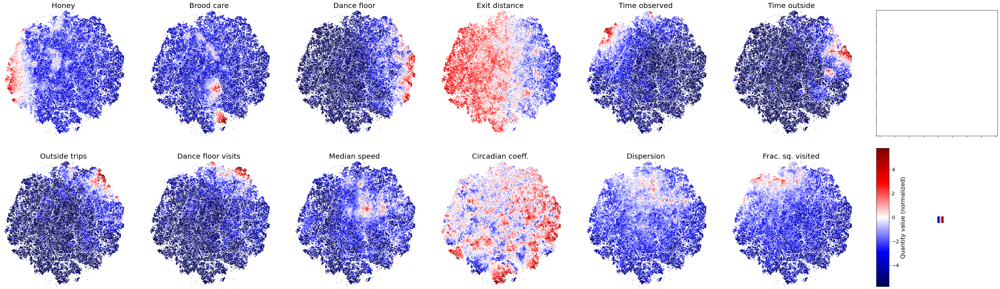

In [63]:
basesize=7
numrows=2
numcols = np.ceil((len(pcacolnames))/numrows).astype(int)
f,ax = plt.subplots(numrows,numcols+1,sharex=True,sharey=True)
f.set_size_inches(basesize*ax.shape[1],basesize*ax.shape[0])
# f.set_dpi(300) if savefigures else None

# the min/max needs to be symmetric, because white in the plot should be zero
minq, maxq = np.quantile(pcamat,[0.001,0.999])
minmaxq = np.max(np.abs([minq,maxq]))

for j in range(len(pcacolnames)):
    r,c = np.divmod(j,numcols)
    a = ax[r,c]
    to_show = pcamat[:,j].copy()
    to_show[to_show<-minmaxq] = -minmaxq
    to_show[to_show>minmaxq] = minmaxq
    bp.plot_tsne_withcolors(a,tsne_result,to_show,pcacolnames[j],plotskip=1,colortype='scalar',s=2,alphaval=0.3,cmapname='seismic',qmin=0,qmax=1)  #,qmin=0,qmax=1)
    a.set_title(pcacolnames[j],fontsize=20)
    a.axis('off')

# colorbar
a = ax[-1,-1]
a.axis('off')
raster = a.pcolormesh(np.arange(10),np.arange(10),minmaxq * np.tile(np.linspace(-1,1,10),(10,1)),cmap='seismic',vmin=-minmaxq,vmax=minmaxq,shading='nearest')
position=f.add_axes([a._position.bounds[0]+0.,a._position.bounds[1]+0.0,.01,0.755/2])
cbar=plt.colorbar(raster,ax=a,cax=position,orientation='vertical')    
cbar.set_label('Quantity value (normalized)',fontsize=16)
# ticks = np.arange(-5,5.5,1)
# cbar.set_ticks(ticks)
# ticks=[str(t) for t in ticks]
# cbar.set_ticklabels(ticks)
cbar.ax.tick_params(labelsize=14)   

# plt.savefig('../image-output/tsne_pca_coloring.pdf',dpi=300)
pdf.savefig(f) if savefigures else None
plt.show()

## Per-cluster distributions

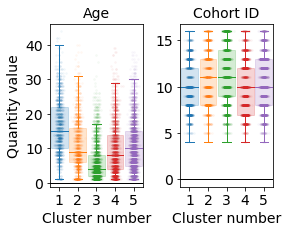

In [69]:
cohortids = dfday_selected['Cohort ID']
for n_clusters in nc_toshow:
    f,ax = plt.subplots(1,2,sharex=True,sharey=False)
    f.set_size_inches(2*2,3)
    f,ax = bp.quantitydists(n_clusters,getmembership(n_clusters,Z),[age,cohortids],['Age','Cohort ID'],f=f,ax=ax,pointskip=5)
    plt.subplots_adjust(wspace=0.4)
    pdf.savefig(f) if savefigures else None
    plt.show()

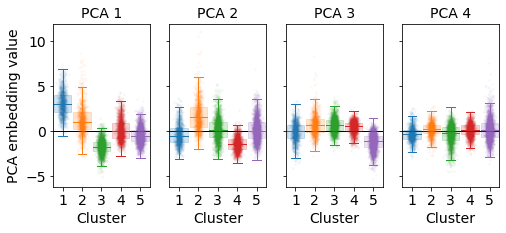

In [104]:
numpcatoshow=4

for cn, n_clusters in enumerate(nc_toshow):
    f,ax = plt.subplots(1,numpcatoshow,sharex=True,sharey=True)
    f.set_size_inches(2*len(ax),3)
    f,ax = bp.quantitydists(n_clusters,getmembership(n_clusters,Z),u[:,0:numpcatoshow].T,['PCA ' +str(j+1) for j in range(numpcatoshow)],
                         f=f,ax=ax,pointskip=5)
    [a.tick_params(labelsize=14) for a in ax]
    [a.set_xlabel('Cluster',fontsize=14) for a in ax]
    ax[0].set_ylabel('PCA embedding value',fontsize=14)
    pdf.savefig(f) if savefigures else None
    plt.show()

In [75]:
## median age per cluster
n_clusters = nc_toshow[0]
membership = getmembership(n_clusters,Z)
median_age_per_cluster = [np.median(age[membership==i]) for i in range(n_clusters)]
pd.DataFrame(np.array([np.arange(n_clusters)+1,median_age_per_cluster]).T,columns=['Cluster number','Median age (days)']).set_index('Cluster number')

,Median age (days)
Cluster number,
1.0,15.0
2.0,9.0
3.0,4.0
4.0,8.0
5.0,10.0


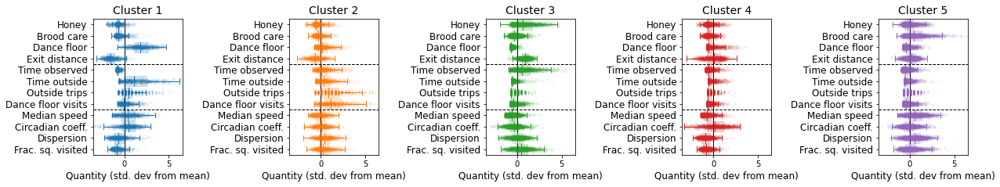

In [65]:
for n_clusters in nc_toshow:
    f,ax = bp.categorydists(n_clusters,getmembership(n_clusters,Z),pcamat.T,pcacolnames,pointskip=5,npoints_in_title=False)
    ax[0].set_xlim([-3.5,6.5])
    for a in ax:
        [a.axhline(div,c='k',linestyle='--',linewidth=1) for div in [3.5,7.5]]  # for three "categories" of metrics
    plt.subplots_adjust(wspace=1.2)
    pdf.savefig(f) if savefigures else None
    plt.show()

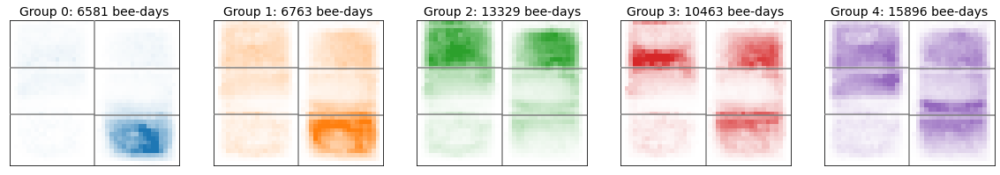

In [66]:
# Display histograms.  First load histogram data if not loaded yet

for n_clusters in nc_toshow:
    f,ax = histograms_per_group(n_clusters,getmembership(n_clusters,Z),dayhist)
    pdf.savefig(f) if savefigures else None
    plt.show()

## CLOSE FIGURE SAVING

In [67]:
pdf.close() if savefigures else None
savefigures=False

# (D) Bee-life (Fig 4, S4)

In [19]:
savefigures = False
coloroffset = 4
if savefigures:
    pdf = matplotlib.backends.backend_pdf.PdfPages(imagedir+'beelife.pdf')

## PCA on lifetime metrics

In [57]:
nanfill = 'colmean'  # [0,'rowmean','colmean']  ### I THINK COLMEAN IS THE BEST/MOST CONSISTENT
deadzerofill = False  # if dim is low (e.g. 2) then this does not affect results much.  If dim is higher, then this affect the results

#  this should ONLY be used for bee-life calculations.  Better if all other things use 'get perbee values' instead
def get_beelife_mats(maxage,min_dayobs,dim,nanfill='colmean',deadzerofill=False):
    all_embedmat = np.tile(np.nan,(len(allbee_uids),maxage+1,dim))
    all_perbeepcamat = np.tile(np.nan,(len(allbee_uids),maxage+1,pcamat.shape[1]))
    all_daynums = np.tile(np.nan,(len(allbee_uids),maxage+1))    
    for i,uid in enumerate(allbee_uids):
        beesel = ids==uid
        bee_age = age[beesel].astype(int)
        # use pca embeddings
        bee_embeddings = u[beesel,:dim]
        bee_pca = pcamat[beesel]
        all_embedmat[i,bee_age[bee_age<=maxage]] = bee_embeddings[bee_age<=maxage]
        all_perbeepcamat[i,bee_age[bee_age<=maxage]] = bee_pca[bee_age<=maxage]
        all_daynums[i,bee_age[bee_age<=maxage]] = daynums[beesel][bee_age<=maxage]

    # remove day 0, because have a lot of nans there
    all_embedmat = all_embedmat[:,1:,:]
    all_perbeepcamat = all_perbeepcamat[:,1:,:]
    all_daynums = all_daynums[:,1:]
    # remove bees that have nans on the first day; these are in earlier cohorts, better to exclude them
    # also, remove any bees with less than min_dayobs
    numdayobs = np.sum(np.logical_not(np.isnan(all_embedmat[:,:,0])),axis=1)
    dayobssel = numdayobs>=min_dayobs
    firstdaysel = np.logical_not(np.isnan(all_embedmat[:,0,0]))
    tokeep = dayobssel & firstdaysel

    all_embedmat = all_embedmat[tokeep]
    all_perbeepcamat = all_perbeepcamat[tokeep]
    all_daynums = all_daynums[tokeep]
    bee_uids = allbee_uids[tokeep]
    bee_cohortids = allbee_cohortids[tokeep]
    bee_numdayobs = numdayobs[tokeep]
    bee_daysalive = allbee_daysalive[tokeep]
    
    
    if deadzerofill:
        for j in range(all_embedmat.shape[0]):
            all_perbeepcamat[j,bee_daysalive[j]:] = 0
            all_embedmat[j,bee_daysalive[j]:] = 0

    corrmat = fill_and_tensordot(all_embedmat,nanfill=nanfill)
    
    return all_embedmat, all_perbeepcamat, bee_uids, bee_cohortids, bee_numdayobs, bee_daysalive, corrmat, tokeep, all_daynums

In [58]:
# Settings
maxage = 25
dim = pcamat.shape[1]  # number of pca components to use  
min_dayobs = 10  # the minimum.  if make 15, then don't get the 'quick-to-forage' bees, because their median num days lives in 19

all_embedmat, all_perbeepcamat, bee_uids, bee_cohortids, bee_numdayobs, bee_daysalive, corrmat, tokeep_beelife,_ = get_beelife_mats(maxage,min_dayobs,dim)

print(all_embedmat.shape)

(2027, 25, 12)


In [59]:
## PCA on bee life
pcamat_beelife = tensorfill(all_perbeepcamat.copy(),nanfill='colmean')
pcamat_beelife = np.reshape(pcamat_beelife,(pcamat_beelife.shape[0],-1))
pcabeelife = PCA(n_components=pcamat_beelife.shape[1]).fit(pcamat_beelife)
vhbeelife = pcabeelife.components_
ubeelife = pcabeelife.transform(pcamat_beelife)
pcavarbeelife = pcabeelife.explained_variance_ratio_
np.round(pcavarbeelife[0:10],4)

array([0.1139, 0.084 , 0.0383, 0.0318, 0.0226, 0.0191, 0.0175, 0.0123,
       0.0122, 0.0117])

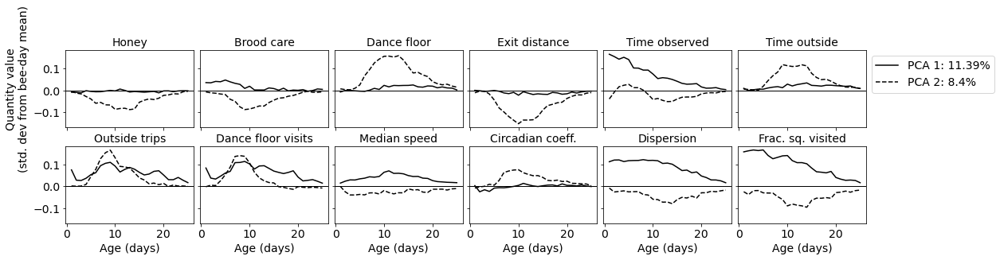

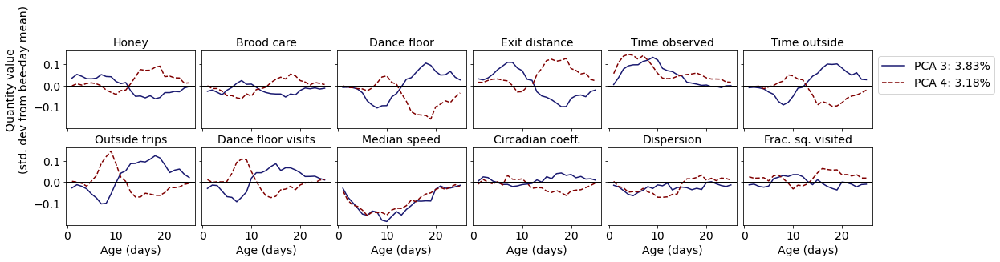

In [60]:
results = np.reshape(vhbeelife,(vhbeelife.shape[0],maxage,-1))
numcols=6

pcacolors = ['k','k','midnightblue','maroon']
linestyles = ['-','--','-','--']
for whichpcas in [[0,1],[2,3]]:
    f,ax = plt.subplots(2,numcols,sharex=True,sharey=True)
    f.set_size_inches(3*ax.shape[1],2*ax.shape[0])
    tpx = np.arange(1,maxage+1)
    # plot means
    for qnum in range(len(pcacolnames)):
        m, d = np.divmod(qnum,numcols)
        a = ax[m,d]
        a.set_title(pcacolnames[qnum],fontsize=14)
        for i in whichpcas:
            a.plot(tpx,results[i,:,qnum],c=pcacolors[i],linestyle=linestyles[i],label='PCA '+str(i+1)+": "+str(np.round(pcavarbeelife[i]*100,2))+'%')
        a.axhline(0,color='k',linewidth=1)
        a.tick_params(labelsize=14)
    plt.subplots_adjust(wspace=0.05,hspace=0.25)
    ax[0,0].set_ylabel('Quantity value\n(std. dev from bee-day mean)',fontsize=14)
    [a.set_xlabel('Age (days)',fontsize=14) for a in ax[1,:]]
#     ax[-1,-1].axis('off')
    ax[0,-1].legend(fontsize=14,bbox_to_anchor=(1,1))
    pdf.savefig(f) if savefigures else None
    # plt.savefig('../image-output/temp.pdf')
    plt.show()



In [61]:
def pcaerrorbar(ax,vh,ylabels,colors='',std=[]):
    numev = vh.shape[0]
    xlim = 1.05*np.max(np.abs(vh))
    for evnum in range(numev):
        a=ax[evnum]
        x=vh[evnum]
        y = np.flipud(np.arange(vh.shape[1]))
    #     ax.plot(x,y,'-o',label='$\\vec e_'+str(evnum)+'$: '+str(np.round(pcavar[evnum]*100,1))+'%',c=snscolors[evnum])
        thickness=0.75
        if len(std)==0:
            a.scatter(x,y+0*(evnum-1)*thickness,color=colors[evnum],alpha=0.5)
        else:
            err=std[evnum]
            a.errorbar(x,y+0*(evnum-1)*thickness,xerr=err,fmt='o',capsize=thickness*5,c='grey')
        a.set_yticks(y)
        a.set_yticklabels(ylabels,rotation='horizontal',fontsize=12)
    [a.axvline(0,c='k',linewidth=1) for a in ax]
#         a.set_title(label='$\\vec v_'+str(evnum)+'$: '+str(np.round(pcavar[evnum]*100,1))+'%',fontsize=14)
#         a.set_xlim([-xlim,xlim])

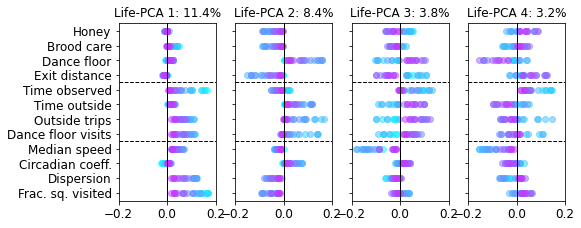

In [62]:
numev_toshow=4
f,ax = plt.subplots(1,numev_toshow,sharex=True,sharey=True)
scalesize=1
f.set_size_inches(2*numev_toshow*scalesize,3/11*len(pcacolnames)*scalesize)
for j in range(25):
    pcaerrorbar(ax,results[:numev_toshow,j],pcacolnames,colors=np.tile(cmapcool(j/agemax_forplot),(numev_toshow,1)))
for j in range(numev_toshow):
    a = ax[j]
    a.set_title('Life-PCA '+str(j+1)+': '+str(round(pcavarbeelife[j]*100,1))+'%',fontsize=12)
    [a.axhline(div,c='k',linestyle='--',linewidth=1) for div in [3.5,7.5]]  # for three "categories" of metrics
    a.set_xlim([-0.2,0.2])
    a.tick_params(labelsize=12)

pdf.savefig(f) if savefigures else None    
plt.savefig(imagedir+'temp.pdf')

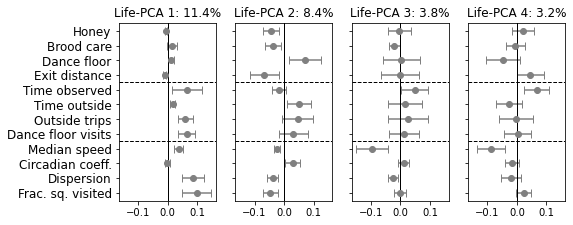

In [63]:
# another way of showing - with mean and error bars
vhlifeavg = np.mean(results,axis=1)
vhlifestd = np.std(results,axis=1)

f,ax = plt.subplots(1,numev_toshow,sharex=True,sharey=True)
scalesize=1
f.set_size_inches(2*numev_toshow*scalesize,3/11*len(pcacolnames)*scalesize)
pcaerrorbar(ax,vhlifeavg[:numev_toshow],pcacolnames,std=vhlifestd)
for j in range(numev_toshow):
    a = ax[j]
    a.set_title('Life-PCA '+str(j+1)+': '+str(round(pcavarbeelife[j]*100,1))+'%',fontsize=12)
    [a.axhline(div,c='k',linestyle='--',linewidth=1) for div in [3.5,7.5]]  # for three "categories" of metrics
pdf.savefig(f) if savefigures else None    
plt.show()

## Clustering and embedding

In [64]:
start = time.time()
Z_life = linkage(pcamat_beelife,'ward')
print('clustering done in ',np.round(time.time()-start,2),'sec')

# Function to use later that selects based on clusters
def get_perbee_values(n_clusters,n_clusters_life,use_lifecat_sel = False, maxage_raster = 59,min_dayobs_raster =2): # the minimum, for displaying or using
    if use_lifecat_sel:
#         maxage_raster = maxage
        min_dayobs_raster = min_dayobs
          
    # Calculations
    ###########################################
    lifemem = fcluster(Z_life, n_clusters_life, criterion='maxclust')-1
    daymem = getmembership(n_clusters,Z)
    perbeecategories = np.tile(np.nan,(len(allbee_uids),maxage_raster))
    perbeedaynums = np.tile(np.nan,(len(allbee_uids),maxage_raster))
    perbee_pcamat = np.tile(np.nan,(len(allbee_uids),maxage_raster,pcamat.shape[1]))
    perbee_pcaembed = np.tile(np.nan,(len(allbee_uids),maxage_raster,pcamat.shape[1]))
    perbeecategories_list = []
    perbeeage_list = []
    perbee_tsne = []
    perbee_hist = []
    for i,uid in enumerate(allbee_uids):
        beesel = ids==uid
        bee_age = age[beesel].astype(int)
        # get categories for this bee
        bee_cats = daymem[beesel]
        bee_daynums = daynums[beesel]
        bee_pcamat = pcamat[beesel]
        bee_pcaembed = u[beesel]
        perbee_tsne.append(tsne_result[beesel])
        perbeecategories[i,bee_age[bee_age<maxage_raster]] = bee_cats[bee_age<maxage_raster]
        perbeedaynums[i,bee_age[bee_age<maxage_raster]] = bee_daynums[bee_age<maxage_raster]
        perbee_pcamat[i,bee_age[bee_age<maxage_raster]] = bee_pcamat[bee_age<maxage_raster]
        perbee_pcaembed[i,bee_age[bee_age<maxage_raster]] = bee_pcaembed[bee_age<maxage_raster]
        perbeecategories_list.append(bee_cats)
        perbeeage_list.append(bee_age)
        perbee_hist.append(dayhist[beesel])
        

    # also, remove any bees with less than min_dayobs
    numdayobs = np.sum(np.logical_not(np.isnan(perbeecategories)),axis=1)
    dayobssel = numdayobs>=min_dayobs_raster
    
    if use_lifecat_sel:
        tokeep_raster = tokeep_beelife
    else:
        tokeep_raster = dayobssel

    bee_cohortids = allbee_cohortids[tokeep_raster]  # note that this is indeed sorted
    bee_numdayobs = numdayobs[tokeep_raster]
    bee_daysalive = allbee_daysalive[tokeep_raster]
    
    perbeecategories = perbeecategories[tokeep_raster]
    perbeecategories_list = np.array(perbeecategories_list)[tokeep_raster]
    perbeeage_list = np.array(perbeeage_list)[tokeep_raster]
    perbee_tsne = np.array(perbee_tsne)[tokeep_raster]
    perbee_hist = np.array(perbee_hist)[tokeep_raster]
    perbee_pcamat = perbee_pcamat[tokeep_raster]
    perbee_pcaembed = perbee_pcaembed[tokeep_raster]
    
    print(perbeecategories.shape)

    cohortchanges = np.argwhere(np.diff(bee_cohortids)>0) + 0.5
    return perbeecategories, perbeecategories_list, perbeeage_list, bee_cohortids, bee_numdayobs, bee_daysalive, perbee_tsne, perbee_pcamat, perbee_pcaembed, perbee_hist, perbeedaynums, lifemem, cohortchanges, maxage_raster


clustering done in  0.38 sec


In [65]:
nc_toshow = [5]

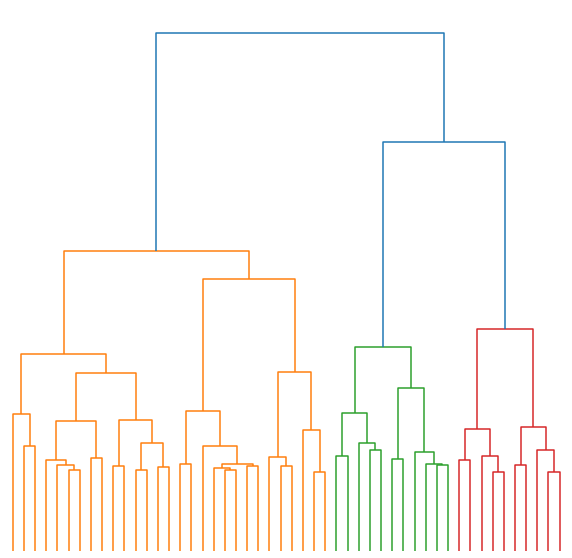

In [66]:
f, ax = plt.subplots(1,1)
f.set_size_inches(10,10)

dendrogram(
    Z_life,
    truncate_mode='lastp',  # show only the last p merged clusters
    p=50,  # show only the last p merged clusters
    show_leaf_counts=False,  # otherwise numbers in brackets are counts
    leaf_rotation=90.,
    leaf_font_size=12.,
    show_contracted=False,  # to get a distribution impression in truncated branches
    ax=ax
)
ax.axis('off')
pdf.savefig(f) if savefigures else None
plt.show()

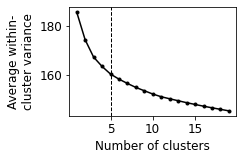

In [67]:
nc_toplot = np.arange(1,20,1)

# average within-cluster variance of distance to the center of the cluster (NOT pairwise)
avgdist = np.zeros(len(nc_toplot))
for i, n in enumerate(nc_toplot):
    membership = fcluster(Z_life, n, criterion='maxclust')-1
    variances = (np.concatenate([np.sum((pcamat_beelife[membership==k] - np.mean(pcamat_beelife[membership==k],axis=0))**2,axis=-1) for k in range(n)]))
    avgdist[i] = np.mean(variances)
#     c = [np.sum(membership==k) for k in range(n)]
#     d = [avgdist_fast(u[membership==k]) for k in range(n)]
#     avgvar_pairwise[i] = np.dot(c,d)/u.shape[0]
    
    
# make the plot
f,ax = plt.subplots(1,1)
f.set_size_inches(3,2)
ax.plot(nc_toplot,avgdist,marker='.',c='k')
# ax.plot(nc_toplot,avgvar_pairwise,marker='.',c='b')
ax.tick_params(labelsize=12)
ax.set_ylabel('Average within-\ncluster variance',fontsize=12)
ax.set_xlabel('Number of clusters',fontsize=12)
ax.axvline(nc_toshow[0],color='k',linewidth=1,linestyle='--')
# plt.savefig('../image-output/tempvar-bl.pdf')
pdf.savefig(f) if savefigures else None
plt.show()

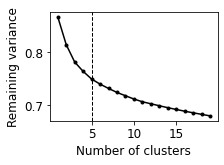

In [100]:
nc_toplot = np.arange(1,20)
vf = np.zeros_like(nc_toplot).astype(float)
for i,n_clusters in enumerate(nc_toplot):
    membership = fcluster(Z_life, n_clusters, criterion='maxclust')-1
    vf[i] = variancebycategory(pcamat_beelife,membership)
    
f,ax = plt.subplots(1,1)
f.set_size_inches(3,2)
ax.plot(nc_toplot,1-vf,marker='.',c='k')
# ax.set_ylim(top=1)
# ax.plot(nc_toplot,avgvar_pairwise,marker='.',c='b')
ax.tick_params(labelsize=12)
ax.set_ylabel('Remaining variance',fontsize=12)
ax.set_xlabel('Number of clusters',fontsize=12)
ax.axvline(nc_toshow[0],color='k',linewidth=1,linestyle='--')
plt.savefig(imagedir+'temp-blvar.pdf')
pdf.savefig(f) if savefigures else None
plt.show()    

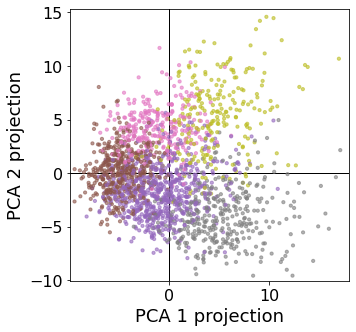

In [155]:
## Main one
n_clusters = nc_toshow[0]
pointsize, alphaval = 10, 0.6
f,ax = plt.subplots(1,1,sharex=True,sharey=True)
f.set_size_inches(5,5)
f.set_dpi(300) if savefigures else None

a=ax
membership = fcluster(Z_life, n_clusters, criterion='maxclust')-1
selorder = np.arange(len(membership))
np.random.shuffle(selorder)
bp.plot_tsne_withcolors(a,ubeelife[selorder,0:2],membership[selorder],'',colortype='cat',s=pointsize,alphaval=alphaval,coloroffset=coloroffset,qmin=0,qmax=1)
# bp.plot_tsne_withcolors(ax[-1],tsne_tp,ubeelife[:,2],'pca 3',colortype='scalar',s=pointsize,alphaval=alphaval,coloroffset=coloroffset,qmin=0,qmax=1)
a.set_xlim(1.05*np.array([np.min(ubeelife[:,0]),np.max(ubeelife[:,0])]))
a.set_ylim(1.05*np.array([np.min(ubeelife[:,1]),np.max(ubeelife[:,1])]))
a.axhline(0,color='k',zorder=-10,linewidth=1)
a.axvline(0,color='k',zorder=-10,linewidth=1)
ax.tick_params(labelsize=16)
ax.set_ylabel('PCA 2 projection',fontsize=18)
ax.set_xlabel('PCA 1 projection',fontsize=18)
pdf.savefig(f) if savefigures else None
# plt.savefig(imagedir+'temp2.pdf')
plt.show()

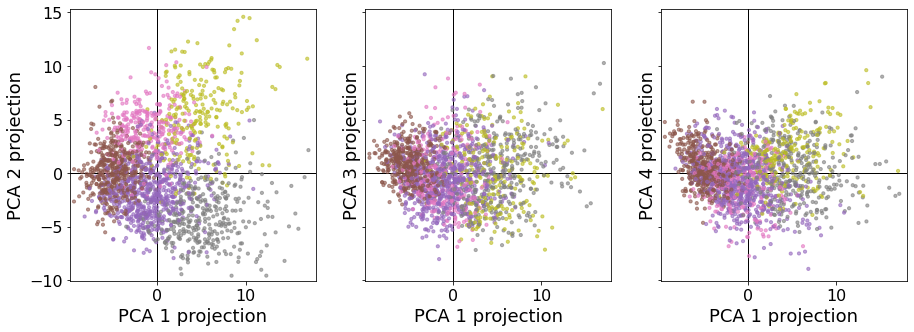

In [156]:
## show different axes
numpca = 4
n_clusters = nc_toshow[0]
pointsize, alphaval = 10, 0.6
f,ax = plt.subplots(1,numpca-1,sharex=True,sharey=True)
f.set_size_inches(5*len(ax),5)

membership = fcluster(Z_life, n_clusters, criterion='maxclust')-1
selorder = np.arange(len(membership))
np.random.shuffle(selorder)
for j in range(numpca-1):
    a=ax[j]
    bp.plot_tsne_withcolors(a,np.array([ubeelife[selorder,0],ubeelife[selorder,j+1]]).T,membership[selorder],'',colortype='cat',s=pointsize,alphaval=alphaval,coloroffset=coloroffset,qmin=0,qmax=1)
    a.axhline(0,color='k',zorder=-10,linewidth=1)
    a.axvline(0,color='k',zorder=-10,linewidth=1)
    a.tick_params(labelsize=16)
    a.set_xlabel('PCA 1 projection',fontsize=18)
    a.set_ylabel('PCA '+str(j+2)+' projection',fontsize=18)
ax[0].set_xlim(1.05*np.array([np.min(ubeelife[:,0]),np.max(ubeelife[:,0])]))
ax[0].set_ylim(1.05*np.array([np.min(ubeelife[:,1]),np.max(ubeelife[:,1])]))


pdf.savefig(f) if savefigures else None
# plt.savefig('../image-output/temp2.pdf')
plt.show()

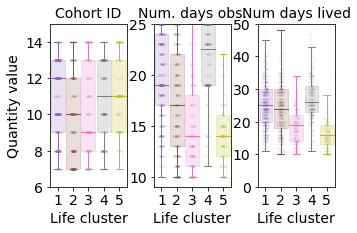

In [32]:
for cn,n_clusters in enumerate(nc_toshow):
# n_clusters = 5
    f,ax = plt.subplots(1,3,sharex=True,sharey=False)
    f.set_size_inches(1.7*len(ax),3)
    f,ax = bp.quantitydists(n_clusters,fcluster(Z_life, n_clusters, criterion='maxclust')-1,[bee_cohortids,bee_numdayobs,bee_daysalive],['Cohort ID','Num. days obs.','Num days lived'],
                         f=f,ax=ax,coloroffset=coloroffset)
    ax[0].set_ylim([6,15])
    ax[1].set_ylim([min_dayobs-1,maxage])
    ax[2].set_ylim([0,50])
    [a.tick_params(labelsize=14) for a in ax]
    [a.set_xlabel('Life cluster',fontsize=14) for a in ax]
    plt.subplots_adjust(wspace=0.35)
    pdf.savefig(f) if savefigures else None
    plt.savefig(imagedir+'beelife-dayslived.pdf')
    plt.show()

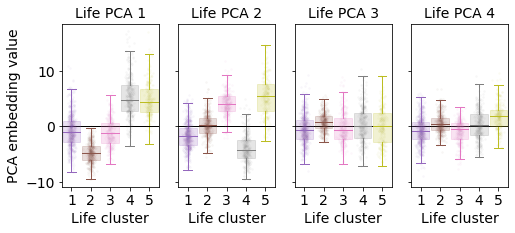

In [158]:
numpcatoshow=4

for cn, n_clusters in enumerate(nc_toshow):
    f,ax = plt.subplots(1,numpcatoshow,sharex=True,sharey=True)
    f.set_size_inches(2*len(ax),3)
    f,ax = bp.quantitydists(n_clusters,fcluster(Z_life, n_clusters, criterion='maxclust')-1,ubeelife[:,0:numpcatoshow].T,['Life PCA ' +str(j+1) for j in range(numpcatoshow)],
                         f=f,ax=ax,coloroffset=coloroffset)
#     ax[0].set_ylim([6,15])
#     ax[1].set_ylim([min_dayobs-1,maxage])
    [a.tick_params(labelsize=14) for a in ax]
    [a.set_xlabel('Life cluster',fontsize=14) for a in ax]
    ax[0].set_ylabel('PCA embedding value',fontsize=14)
    pdf.savefig(f) if savefigures else None
    plt.show()

## Quantities per-cluster over time

In [93]:
n_clusters = 5
n_clusters_life = 5
perbeecategories, perbeecategories_list, perbeeage_list, bee_cohortids, bee_numdayobs, bee_daysalive, perbee_tsne, perbee_pcamat, perbee_pcaembed, perbee_hist, perbeedaynums, lifemem, cohortchanges, maxage_raster = get_perbee_values(n_clusters,n_clusters_life,use_lifecat_sel = True,maxage_raster=np.max(bee_daysalive))

(2027, 59)


<ipython-input-90-e16548e1749e>:55: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  perbeecategories_list = np.array(perbeecategories_list)[tokeep_raster]
<ipython-input-90-e16548e1749e>:56: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  perbeeage_list = np.array(perbeeage_list)[tokeep_raster]
<ipython-input-90-e16548e1749e>:57: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dty

/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/env

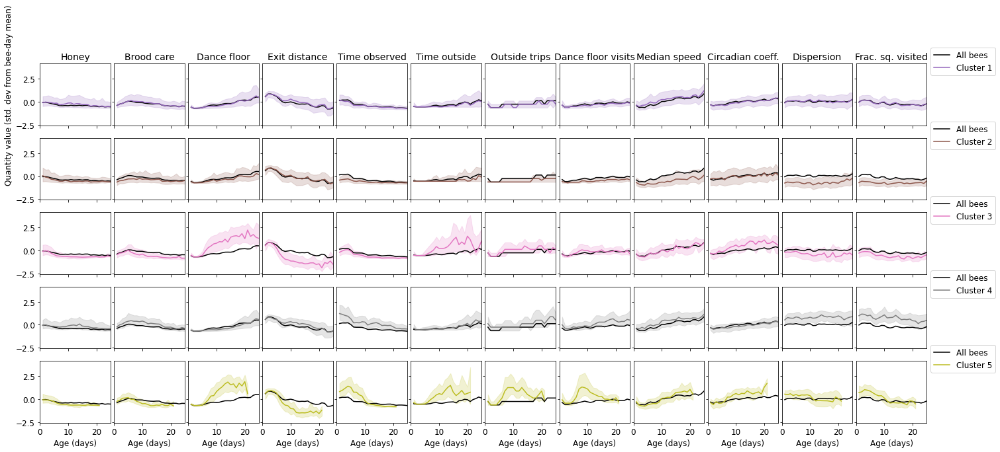

In [43]:
#### HORIZONTAL PLOT ####
whichplot = 'metrics'

if whichplot == 'metrics':
    data_to_plot = perbee_pcamat
    numtoplot = pcamat.shape[1]
    pcacolnames_tp = pcacolnames
elif whichplot == 'pca':
    data_to_plot = perbee_pcaembed
    numtoplot = 4
    pcacolnames_tp = ['Bee-day PCA '+str(i) for i in range(numtoplot)]

    
for n_clusters in nc_toshow:

    lifemem = fcluster(Z_life, n_clusters, criterion='maxclust')-1

    f,ax = plt.subplots(n_clusters,numtoplot,sharex=True,sharey=True)
    f.set_size_inches(2*numtoplot,2*n_clusters)
    tpx = np.arange(1,30)

    # plot means
    quantiles_tp = np.nanquantile(data_to_plot,[0.25,0.5,0.75],axis=0).T
    for i in range(numtoplot):
        for j in range(n_clusters):
            a = ax[j,i]
            a.plot(tpx,quantiles_tp[i,tpx,1],c='k',label='All bees')
#             a.fill_between(tpx,quantiles_tp[i,:,0],quantiles_tp[i,:,2],color='k',alpha=0.2)

    for catnum in range(n_clusters):
        quantiles_tp = np.nanquantile(data_to_plot[lifemem==catnum],[0.25,0.5,0.75],axis=0).T
        counts_tp = np.sum(np.logical_not(np.isnan(data_to_plot[lifemem==catnum])),axis=0).T
        quantiles_tp[counts_tp<10] = np.nan  # don't show these ones, that thave
        for i in range(numtoplot):
            a = ax[catnum,i]
#             a = ax[catnum,i]
            clr = bp.snscolors[catnum+(coloroffset)]
            a.plot(tpx,quantiles_tp[i,tpx,1],c=clr,label='Cluster '+str(catnum+1))
            a.fill_between(tpx,quantiles_tp[i,tpx,0],quantiles_tp[i,tpx,2],color=clr,alpha=0.2)
            yp = data_to_plot[lifemem==catnum,:,i][:,tpx]
#             a.plot(np.tile(tpx,(len(yp),1)).T,yp.T,c=clr,alpha=0.1)  # This has too many lines, its not informative

    [a.legend(fontsize=12,bbox_to_anchor=(1, 0.75)) for a in ax[:,-1]]
#     ax[0].set_ylim([-2,2])
    ax[0,0].set_xlim([0,maxage])
    ax[0,0].set_ylabel('Quantity value (std. dev from bee-day mean)',fontsize=12)
    [a.set_xlabel('Age (days)',fontsize=12) for a in ax[-1]]
    [[a.tick_params(labelsize=12) for a in aa] for aa in ax]
    [[a.set_xticks([0,10,20]) for a in aa] for aa in ax]
    [ax[0,i].set_title(pcacolnames_tp[i],fontsize=14) for i in range(numtoplot)]
    plt.subplots_adjust(wspace=0.05)
    pdf.savefig(f) if savefigures else None
    plt.savefig(imagedir+'temp.pdf')
    plt.show()

/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/envs/bees2/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1389: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,
/home/jacob/anaconda3/env

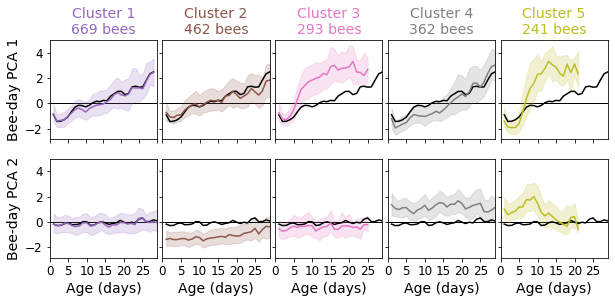

In [164]:
#### VERTICAL PLOT ####
whichplot = 'pca'

if whichplot == 'metrics':
    data_to_plot = perbee_pcamat
    numtoplot = pcamat.shape[1]
    pcacolnames_tp = pcacolnames
elif whichplot == 'pca':
    data_to_plot = perbee_pcaembed
    numtoplot = 2
    pcacolnames_tp = ['Bee-day PCA 1','Bee-day PCA 2']

for n_clusters in nc_toshow:
    f,ax = plt.subplots(numtoplot,n_clusters,sharex=True,sharey=True)
    f.set_size_inches(2*n_clusters,2*numtoplot)
    lifemem = fcluster(Z_life, n_clusters, criterion='maxclust')-1

    tpx = np.arange(1,30)

    # plot means
    quantiles_tp = np.nanquantile(data_to_plot,[0.25,0.5,0.75],axis=0).T
    for i in range(numtoplot):
        for j in range(n_clusters):
            a = ax[i,j]
            a.plot(tpx,quantiles_tp[i,tpx,1],c='k',label='All bees')
#             a.fill_between(tpx,quantiles_tp[i,:,0],quantiles_tp[i,:,2],color='k',alpha=0.2)

    for catnum in range(n_clusters):
        quantiles_tp = np.nanquantile(data_to_plot[lifemem==catnum],[0.25,0.5,0.75],axis=0).T
        counts_tp = np.sum(np.logical_not(np.isnan(data_to_plot[lifemem==catnum])),axis=0).T
        quantiles_tp[counts_tp<10] = np.nan  # don't show these ones, that thave
        for i in range(numtoplot):
            a = ax[i,catnum]
#             a = ax[catnum,i]
            clr = bp.snscolors[catnum+(coloroffset)]
            labelstr = 'Cluster '+str(catnum+1)+'\n'+str(np.sum(lifemem==catnum))+' bees'
            a.plot(tpx,quantiles_tp[i,tpx,1],c=clr,label=labelstr)
            a.fill_between(tpx,quantiles_tp[i,tpx,0],quantiles_tp[i,tpx,2],color=clr,alpha=0.2)
            a.axhline(0,c='k',linewidth=1,zorder=-10)
            if i==0:
                a.set_title(labelstr,fontsize=14,color=clr)

#     [a.legend(fontsize=12,bbox_to_anchor=(1, 0.75)) for a in ax[:,-1]]
#     ax[0].set_ylim([-2,2])
    ax[0,0].set_xlim([0,tpx[-1]])
    ax[0,0].set_ylabel('Quantity value\n(std. dev from bee-day mean)',fontsize=12)
    ax[0,0].set_xticks([0,5,10,15,20,25,30])
    [a.set_xlabel('Age (days)',fontsize=14) for a in ax[-1]]
    [[a.tick_params(labelsize=12) for a in aa] for aa in ax]
    [ax[i,0].set_ylabel(pcacolnames_tp[i],fontsize=14) for i in range(numtoplot)]
    plt.subplots_adjust(wspace=0.05)
    pdf.savefig(f) if savefigures else None
    plt.show()

## Average bee-day PCA or tSNE trajectories

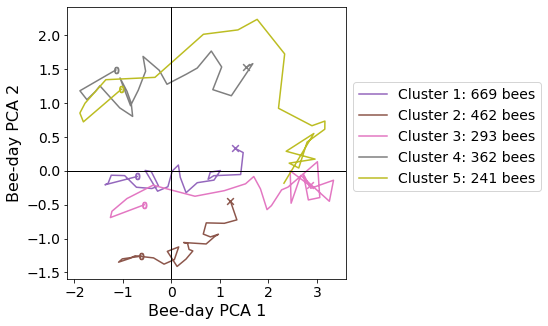

In [165]:
##PCA

numtoplot = 4
pcacolnames_tp = ['Bee-day PCA '+str(i) for i in range(numtoplot)]
maxage_forplot = maxage
    
# for n_clusters in nc_toshow:
n_clusters = 5
f,ax = plt.subplots(1,1,sharex=True,sharey=True)
f.set_size_inches(5,5)
lifemem = fcluster(Z_life, n_clusters, criterion='maxclust')-1

tpx = np.arange(1,maxage_forplot)  # note that the data starts at age 1
data_to_plot = perbee_pcaembed[:,1:maxage_forplot+1,:]


plotmedian = False # True: plot median. False: plot mean
if plotmedian:
# plot means
    lifeaverage = np.nanquantile(data_to_plot,0.5,axis=0)
else: # use this to plot the mean instead
    lifeaverage = np.nanmean(data_to_plot,axis=0)

plotallbees=False
if plotallbees:
    ax.plot(lifeaverage[:,0],lifeaverage[:,1],c='k',label='All bees')
    ax.scatter(lifeaverage[0,0],lifeaverage[0,1],color='k',s=45,zorder=3,marker='$0$')
    ax.scatter(lifeaverage[-1,0],lifeaverage[-1,1],s=45,zorder=3,marker='x',c='k')    

# plot for each category
for catnum in range(n_clusters):
    if plotmedian:
        lifeaverage = np.nanquantile(data_to_plot[lifemem==catnum],0.5,axis=0)
    else:
        lifeaverage = np.nanmean(data_to_plot[lifemem==catnum],axis=0)
    counts_tp = np.sum(np.logical_not(np.isnan(data_to_plot[lifemem==catnum])),axis=0)

    lifeaverage[counts_tp<10] = np.nan  # don't show these ones, that dont have many observarions
    clr = bp.snscolors[catnum+(coloroffset)]
    ax.plot(lifeaverage[:,0],lifeaverage[:,1],c=clr,
            label='Cluster '+str(catnum+1)+': '+str(np.sum(lifemem==catnum))+' bees')
    ax.scatter(lifeaverage[0,0],lifeaverage[0,1],color=[clr],s=45,zorder=3,marker='$0$')
    ax.scatter(lifeaverage[-1,0],lifeaverage[-1,1],s=45,zorder=3,marker='x',color=[clr])    

ax.legend(fontsize=14,bbox_to_anchor=(1, 0.75))
#     ax[0].set_ylim([-2,2])
#     ax[0,0].set_xlim([0,maxage])
#     ax[0,0].set_ylabel('Quantity value\n(std. dev from bee-day mean)',fontsize=12)
#     [a.set_xlabel('Age (days)',fontsize=12) for a in ax[-1]]
ax.tick_params(labelsize=14)
ax.axvline(0,c='k',linewidth=1)
ax.axhline(0,c='k',linewidth=1)
ax.set_xlabel('Bee-day PCA 1',fontsize=16)
ax.set_ylabel('Bee-day PCA 2',fontsize=16)

#     ax[0,i].set_title(pcacolnames_tp[i],fontsize=14) for i in range(numtoplot)]
# plt.savefig('../image-output/temp.pdf')
pdf.savefig(f) if savefigures else None
plt.show()

In [18]:
recalc_an

1


In [22]:
## BEE-DAY tSNE

if recalc_and_save==False:  #don't run the rest of the cell, because 
    class StopExecution(Exception):
        def _render_traceback_(self):
            pass
    print("Need to re-run bee-day tSNE in order to define function 'get_tsne_embedding'")
    print('(i.e. set recalc_and_save=True in bee-day clustering and embedding')
    raise StopExecution

numtoplot = 4
pcacolnames_tp = ['Bee-day PCA '+str(i) for i in range(numtoplot)]
maxage_forplot = maxage
    
# for n_clusters in nc_toshow:
n_clusters = 5
n_clusters_beeday = 5

f,ax = plt.subplots(1,1,sharex=True,sharey=True)
f.set_size_inches(4,4)
lifemem = fcluster(Z_life, n_clusters, criterion='maxclust')-1
tpx = np.arange(1,maxage_forplot)  # note that the data starts at age 1
data_to_plot = perbee_pcamat[:,1:maxage_forplot+1,:]

plotmedian = False # True: plot median. False: plot mean
if plotmedian:
# plot means
    lifeaverage = np.nanquantile(data_to_plot,0.5,axis=0)
else: # use this to plot the mean instead
    lifeaverage = np.nanmean(data_to_plot,axis=0)  
lifeaverage = get_tsne_embedding(lifeaverage)  

plotallbees=False
if plotallbees:
    ax.plot(lifeaverage[:,0],lifeaverage[:,1],c='k',label='All bees')
    ax.scatter(lifeaverage[0,0],lifeaverage[0,1],color='k',s=45,zorder=3,marker='$0$')
    ax.scatter(lifeaverage[-1,0],lifeaverage[-1,1],s=45,zorder=3,marker='x',c='k')    

# plot for each category
for catnum in range(n_clusters):
    if plotmedian:
        lifeaverage = np.nanquantile(data_to_plot[lifemem==catnum],0.5,axis=0)
    else:
        lifeaverage = np.nanmean(data_to_plot[lifemem==catnum],axis=0)
    lifeaverage = get_tsne_embedding(lifeaverage)  
    counts_tp = np.sum(np.logical_not(np.isnan(data_to_plot[lifemem==catnum])),axis=0)
#     lifeaverage[counts_tp<10] = np.nan  # don't show these ones, that dont have many observarions
    clr = bp.snscolors[catnum+(coloroffset)]
    ax.plot(lifeaverage[:,0],lifeaverage[:,1],c=clr,label='Cluster '+str(catnum+1),linewidth=2)
    ax.scatter(lifeaverage[0,0],lifeaverage[0,1],color=[clr],s=45,zorder=3,marker='$0$')
    ax.scatter(lifeaverage[-1,0],lifeaverage[-1,1],s=45,zorder=3,marker='x',color=[clr])    

ax.legend(fontsize=14,bbox_to_anchor=(1, 0.75))
#     ax[0].set_ylim([-2,2])
#     ax[0,0].set_xlim([0,maxage])
#     ax[0,0].set_ylabel('Quantity value\n(std. dev from bee-day mean)',fontsize=12)
#     [a.set_xlabel('Age (days)',fontsize=12) for a in ax[-1]]
ax.tick_params(labelsize=14)
# ax.axvline(0,c='k',linewidth=1)
# ax.axhline(0,c='k',linewidth=1)
# ax.set_xlabel('Bee-day PCA 1',fontsize=16)
# ax.set_ylabel('Bee-day PCA 2',fontsize=16)
bp.plot_tsne_withcolors(ax,tsne_result,getmembership(n_clusters_beeday,Z),'',plotskip=1,colortype='cat',s=3,alphaval=0.015,qmin=0,qmax=1)    
ax.axis('off')
#     ax[0,i].set_title(pcacolnames_tp[i],fontsize=14) for i in range(numtoplot)]
# plt.savefig('../image-output/temp.pdf')
pdf.savefig(f) if savefigures else None
plt.show()

Need to re-run bee-day tSNE in order to define function 'get_tsne_embedding'
(i.e. set recalc_and_save=True in bee-day clustering and embedding


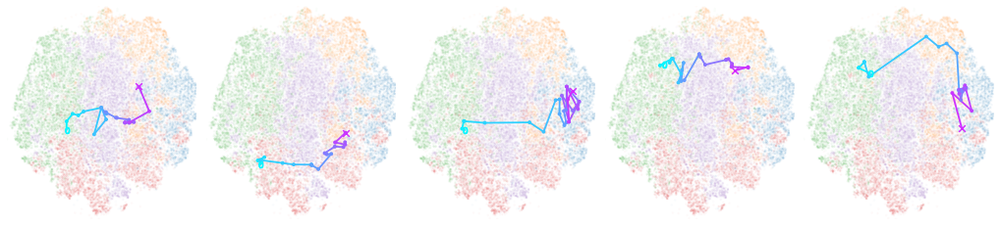

In [167]:
if recalc_and_save==False:  #don't run the rest of the cell, because 
    class StopExecution(Exception):
        def _render_traceback_(self):
            pass
    print("Need to re-run bee-day tSNE in order to define function 'get_tsne_embedding'")
    print('(i.e. set recalc_and_save=True in bee-day clustering and embedding')
    raise StopExecution
    
days_per_plot = 1
maxage_for_display = 30

numcols=n_clusters_life
numrows=1
f,ax = plt.subplots(numrows,numcols,sharex=True,sharey=True)
basesize=4
f.set_size_inches(basesize*numcols*0.9,basesize*(numrows))
# f.set_dpi(300) if savefigures else None


for i in range(n_clusters_life):
    a=ax[i]
    lifeaverage = np.nanmean(data_to_plot[lifemem==i],axis=0)
    lifeaverage = get_tsne_embedding(lifeaverage)  
    btp = lifeaverage
    colordata = np.arange(25)+1
    colordata = colordata/maxage_for_display
    colordata[colordata>1] = 1
    colordata *= 0.99
    linecolors = cmapcool((colordata[0:-1]+colordata[1:])/2)
    pointcolors=cmapcool(colordata)
#     filled_markers = ('o', 'v', '^', '<', '>', '8', 's', 'p', '*', 'h', 'H', 'D', 'd', 'P', 'X')
    a.scatter(btp[0,0],btp[0,1],color=pointcolors[0],s=45,zorder=3,marker='$0$')
    a.scatter(btp[-1,0],btp[-1,1],color=pointcolors[-1],s=45,zorder=3,marker='x')
    a.scatter(btp[1:-1,0],btp[1:-1,1],color=pointcolors[1:-1],s=8,zorder=3)
    segments = np.array([btp[0:-1],btp[1:]]).swapaxes(0,1)
    for j in range(len(segments)):
        a.plot(segments[j,:,0],segments[j,:,1],c=linecolors[j],zorder=2,linewidth=1.8)

# plot this last, so it sets the axes
# a = ax[0]
# bp.plot_tsne_withcolors(a,tsne_result,membership,'All days',plotskip=1,colortype='cat',s=0.5,alphaval=0.2,qmin=0,qmax=1)    
for a in ax:
    bp.plot_tsne_withcolors(a,tsne_result,getmembership(n_clusters,Z),'',plotskip=1,colortype='cat',s=3,alphaval=0.015,qmin=0,qmax=1)    
    a.axis('off')

plt.subplots_adjust(wspace=0.05)
pdf.savefig(f) if savefigures else None
# plt.savefig('../image-output/indivbeetsne.pdf',dpi=300)
plt.show()

## Average metrics across lifetime

In [172]:
lifeaverages = np.nanmean(perbee_pcamat,axis=1)

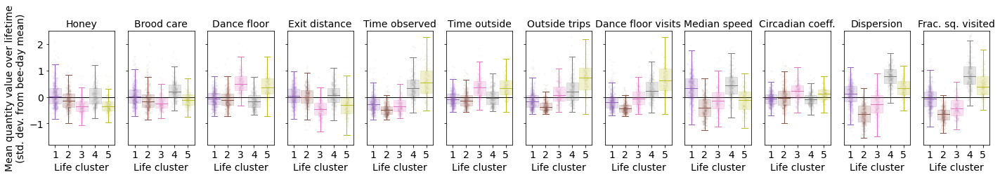

In [173]:
for n_clusters_tp in nc_toshow:

    f,ax = plt.subplots(1,len(pcacolnames),sharex=True,sharey=True)
    f.set_size_inches(2*len(ax),3)
    f,ax = bp.quantitydists(n_clusters_tp,fcluster(Z_life, n_clusters_tp, criterion='maxclust')-1,lifeaverages.T,pcacolnames,
                         f=f,ax=ax,coloroffset=coloroffset)
    #     ax[0].set_ylim([6,15])
    #     ax[1].set_ylim([min_dayobs-1,maxage])
    ax[0].set_ylim([-1.8,2.5])
    [a.set_xlabel('Life cluster',fontsize=14) for a in ax]
    ax[0].set_ylabel('Mean quantity value over lifetime\n(std. dev. from bee-day mean)',fontsize=14)
    pdf.savefig(f) if savefigures else None
#     plt.savefig('../image-output/lifeaverages.pdf')
    plt.show()

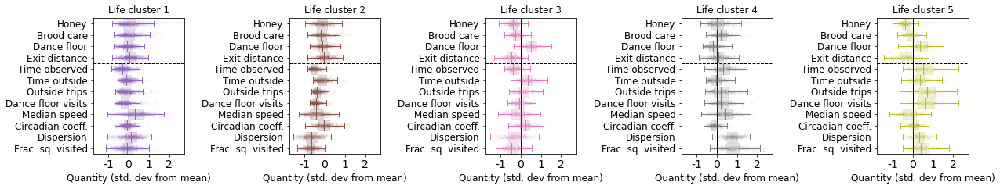

In [174]:
for n_clusters in nc_toshow:
    f,ax = bp.categorydists(n_clusters,fcluster(Z_life, n_clusters_tp, criterion='maxclust')-1,lifeaverages.T,pcacolnames,pointskip=1,npoints_in_title=False,coloroffset=coloroffset)
    for i,a in enumerate(ax):
        ticks=[-2,-1,0,1,2,3]
        a.set_xticks(ticks)
        a.set_xticklabels(ticks,fontsize=12)
        [a.axhline(div,c='k',linestyle='--',linewidth=1) for div in [3.5,7.5]]  # for three "categories" of metrics
        a.set_title('Life cluster '+str(i+1),fontsize=12)
    ax[0].set_xlim([-1.75,2.75])
    plt.subplots_adjust(wspace=1.15)
    pdf.savefig(f) if savefigures else None
    plt.show()

## CLOSE FIGURE SAVING

In [175]:
pdf.close() if savefigures else None
savefigures=False

# (E) Bee-life-related figures not in manuscript

In [159]:
n_clusters = 5
n_clusters_life = 5
perbeecategories, perbeecategories_list, perbeeage_list, bee_cohortids, bee_numdayobs, bee_daysalive, perbee_tsne, perbee_pcamat, perbee_pcaembed, perbee_hist, perbeedaynums, lifemem, cohortchanges, maxage_raster = get_perbee_values(n_clusters,n_clusters_life,use_lifecat_sel = True,maxage_raster=np.max(bee_daysalive))

(2027, 59)


<ipython-input-151-eb936e936a35>:54: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  perbeecategories_list = np.array(perbeecategories_list)[tokeep_raster]
<ipython-input-151-eb936e936a35>:55: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  perbeeage_list = np.array(perbeeage_list)[tokeep_raster]
<ipython-input-151-eb936e936a35>:56: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify '

## Individual bee tsne embeddings - by life category

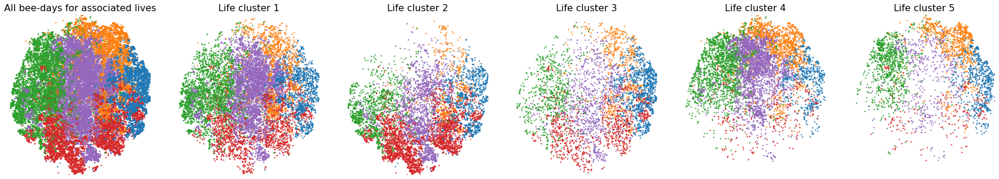

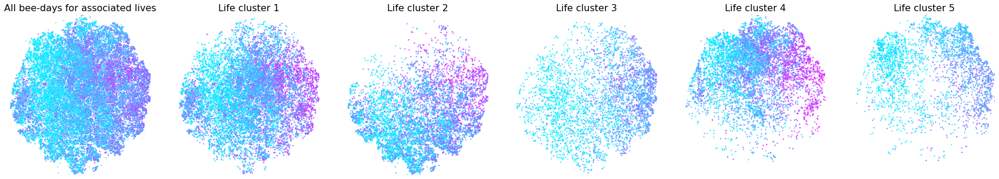

In [160]:
pointsize, alphaval = 2, 0.8

f,ax = plt.subplots(1,n_clusters_life+1,sharex=True,sharey=True)
f.set_size_inches(5*len(ax),5)

for j in range(n_clusters_life):
    sel = lifemem==j
    bp.plot_tsne_withcolors(ax[j+1],np.concatenate(perbee_tsne[sel]),np.concatenate(perbeecategories_list[sel]),'Life cluster '+str(j+1),colortype='cat',s=pointsize,alphaval=alphaval,coloroffset=0,qmin=0,qmax=1)
bp.plot_tsne_withcolors(ax[0],np.concatenate(perbee_tsne),np.concatenate(perbeecategories_list),'All bee-days for associated lives',colortype='cat',s=pointsize,alphaval=alphaval,coloroffset=0,qmin=0,qmax=1)    
[a.axis('off') for a in ax]
pdf.savefig(f) if savefigures else None
plt.show()

pointsize, alphaval = 2, 0.7
f,ax = plt.subplots(1,n_clusters_life+1,sharex=True,sharey=True)
f.set_size_inches(5*len(ax),5)
for j in range(n_clusters_life):
    sel = lifemem==j
    agetp = np.concatenate(perbeeage_list[sel]).copy()
    agetp[agetp>agemax_forplot] = agemax_forplot
    bp.plot_tsne_withcolors(ax[j+1],np.concatenate(perbee_tsne[sel]),agetp,'Life cluster '+str(j+1),colortype='scalar',s=pointsize,alphaval=alphaval,coloroffset=0,qmin=0,qmax=1)
agetp = np.concatenate(perbeeage_list).copy()
agetp[agetp>agemax_forplot] = agemax_forplot    
bp.plot_tsne_withcolors(ax[0],np.concatenate(perbee_tsne),agetp,'All bee-days for associated lives',colortype='scalar',s=pointsize/2,alphaval=alphaval,coloroffset=0,qmin=0,qmax=1)    
[a.axis('off') for a in ax]
pdf.savefig(f) if savefigures else None
plt.show()

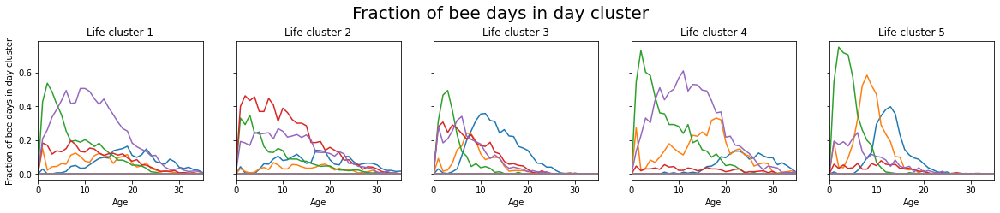

In [161]:
f,ax = plt.subplots(1,n_clusters_life,sharex=True,sharey=True)
f.set_size_inches(4*len(ax),3)
for j in range(n_clusters_life):
    a=ax[j]
    for bdcat in range(8):
        a.plot(np.nanmean(perbeecategories[lifemem==j]==bdcat,axis=0))
    a.set_title('Life cluster '+str(j+1))
    a.set_xlabel('Age')
ax[0].set_xlim([0,35])
ax[0].set_ylabel('Fraction of bee days in day cluster')
plt.suptitle('Fraction of bee days in day cluster',fontsize=20,y=1.07)
plt.show()

## Individual bee example trajectories in bee-day space

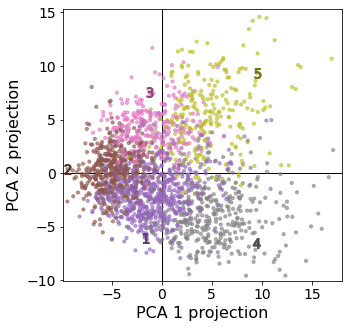

days lived:   [34 32 18 34 16]
days observed:   [33 28 14 34 16]


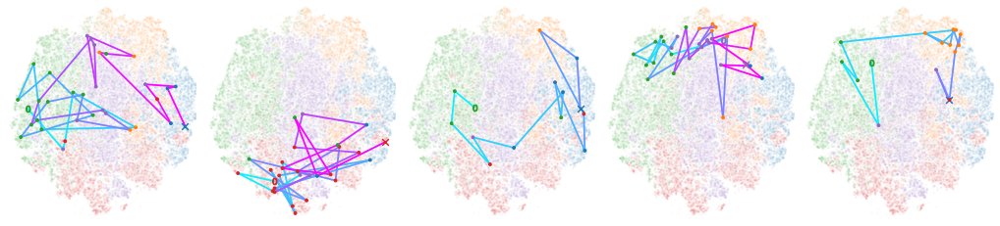

In [170]:
pca1order = np.argsort(ubeelife[:,0])
pca2order = np.argsort(ubeelife[:,1])


clust1x, clust1y = -2,-6
cluster1dist = np.argsort((ubeelife[:,0]-clust1x)**2+(ubeelife[:,1]-clust1y)**2)
clust3x, clust3y = -1,8
cluster3dist = np.argsort((ubeelife[:,0]-clust3x)**2+(ubeelife[:,1]-clust3y)**2)
clust4x, clust4y = 11,-7
cluster4dist = np.argsort((ubeelife[:,0]-clust4x)**2+(ubeelife[:,1]-clust4y)**2)
clust5x, clust5y = 10,11
cluster5dist = np.argsort((ubeelife[:,0]-clust5x)**2+(ubeelife[:,1]-clust5y)**2)

tpbeeid = [cluster1dist[0],pca1order[1],cluster3dist[0],cluster4dist[7],cluster5dist[1]]  




## Main one
pointsize, alphaval = 10, 0.6
f,ax = plt.subplots(1,1,sharex=True,sharey=True)
f.set_size_inches(5,5)
a=ax
membership = fcluster(Z_life, n_clusters_life, criterion='maxclust')-1
selorder = np.arange(len(membership))
np.random.shuffle(selorder)
bp.plot_tsne_withcolors(a,ubeelife[selorder,0:2],membership[selorder],'',colortype='cat',s=pointsize,alphaval=alphaval,coloroffset=coloroffset,qmin=0,qmax=1)
# bp.plot_tsne_withcolors(ax[-1],tsne_tp,ubeelife[:,2],'pca 3',colortype='scalar',s=pointsize,alphaval=alphaval,coloroffset=coloroffset,qmin=0,qmax=1)
a.set_xlim(1.05*np.array([np.min(ubeelife[:,0]),np.max(ubeelife[:,0])]))
a.set_ylim(1.05*np.array([np.min(ubeelife[:,1]),np.max(ubeelife[:,1])]))
a.axhline(0,color='k',zorder=-10,linewidth=1)
a.axvline(0,color='k',zorder=-10,linewidth=1)
ax.tick_params(labelsize=14)
ax.set_ylabel('PCA 2 projection',fontsize=16)
ax.set_xlabel('PCA 1 projection',fontsize=16)

# plt the selected points on top of hte other ones
selmarkers = ['x','x','x','x','x']
for i in range((len(tpbeeid))):
    ax.scatter(ubeelife[tpbeeid[i],0],ubeelife[tpbeeid[i],1],color=bp.snscolors[membership[tpbeeid[i]]+coloroffset]*0.6,s=100,marker='$'+str(i+1)+'$',zorder=20)

pdf.savefig(f) if savefigures else None
# plt.savefig('../image-output/lifepca.pdf',dpi=300)
plt.show()


print('days lived:  ',bee_daysalive[tpbeeid])
print('days observed:  ',bee_numdayobs[tpbeeid])
days_per_plot = 1
maxage_for_display = 30

numcols=n_clusters_life
numrows=1
f,ax = plt.subplots(numrows,numcols,sharex=True,sharey=True)
basesize=4
f.set_size_inches(basesize*numcols*0.9,basesize*(numrows))


for i in range(n_clusters_life):
    a=ax[i]
    beeid = tpbeeid[i]
    pointcolors = bp.snscolors[perbeecategories_list[beeid].astype(int)+0]
    btp = perbee_tsne[beeid]
    colordata = perbeeage_list[beeid]
    colordata = colordata/maxage_for_display
    colordata[colordata>1] = 1
    colordata *= 0.99
    linecolors = cmapcool((colordata[0:-1]+colordata[1:])/2)
#     filled_markers = ('o', 'v', '^', '<', '>', '8', 's', 'p', '*', 'h', 'H', 'D', 'd', 'P', 'X')
    a.scatter(btp[0,0],btp[0,1],color=pointcolors[0],s=45,zorder=3,marker='$0$')
    a.scatter(btp[-1,0],btp[-1,1],color=pointcolors[-1],s=45,zorder=3,marker='x')
    a.scatter(btp[1:-1,0],btp[1:-1,1],color=pointcolors[1:-1],s=8,zorder=3)
    segments = np.array([btp[0:-1],btp[1:]]).swapaxes(0,1)
    for j in range(len(segments)):
        a.plot(segments[j,:,0],segments[j,:,1],c=linecolors[j],zorder=2,linewidth=1.8)

# plot this last, so it sets the axes
# a = ax[0]
# bp.plot_tsne_withcolors(a,tsne_result,membership,'All days',plotskip=1,colortype='cat',s=0.5,alphaval=0.2,qmin=0,qmax=1)    
for a in ax:
    bp.plot_tsne_withcolors(a,tsne_result,getmembership(n_clusters,Z),'',plotskip=1,colortype='cat',s=3,alphaval=0.015,qmin=0,qmax=1)    
    a.axis('off')

plt.subplots_adjust(wspace=0.05)
pdf.savefig(f) if savefigures else None
# plt.savefig('../image-output/indivbeetsne.pdf',dpi=300)
plt.show()



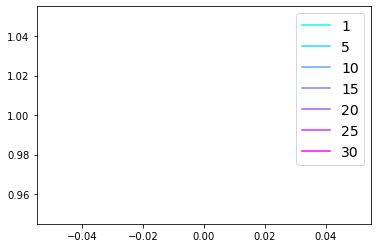

In [171]:
# make a line legend
colordata = np.arange(maxage_for_display+1)
colordata = colordata/maxage_for_display
colordata[colordata>1] = 1
colordata *= 0.99
linecolors = cmapcool((colordata[0:-1]+colordata[1:])/2)
for i in [1,5,10,15,20,25,30]:
    plt.plot([0,0],[1,1],c=linecolors[i-1],label=i)
plt.legend(fontsize=14,bbox_to_anchor=(1,1))
pdf.savefig(f) if savefigures else None


# (F) Cohort and source colony distributions (Fig S5)

In [34]:
savefigures = True
if savefigures:
    pdf = matplotlib.backends.backend_pdf.PdfPages(imagedir+'Cohort-sourcecol.pdf')

In [35]:
n_clusters = 5
n_clusters_life = 5
perbeecategories, perbeecategories_list, perbeeage_list, bee_cohortids, bee_numdayobs, bee_daysalive, perbee_tsne, perbee_pcamat, perbee_pcaembed, perbee_hist, perbeedaynums, lifemem, cohortchanges, maxage_raster = get_perbee_values(n_clusters,n_clusters_life,use_lifecat_sel = True,maxage_raster=np.max(bee_daysalive))

(2027, 59)


<ipython-input-25-e16548e1749e>:55: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  perbeecategories_list = np.array(perbeecategories_list)[tokeep_raster]
<ipython-input-25-e16548e1749e>:56: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  perbeeage_list = np.array(perbeeage_list)[tokeep_raster]
<ipython-input-25-e16548e1749e>:57: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dty

In [36]:
bee_colonynames = np.tile('   ',len(bee_cohortids))
for j in range(bd.numcohorts):
    bee_colonynames[bee_cohortids==j] = int(bd.cohort_colonynames[j][1:])
    bee_colonynames[bee_cohortids==j] = bd.cohort_colonynames[j]
    
combined_unique, combined_counts = np.unique(bee_colonynames, return_counts=True)
combined_unique, combined_counts
n_sourcecol = len(combined_unique)    

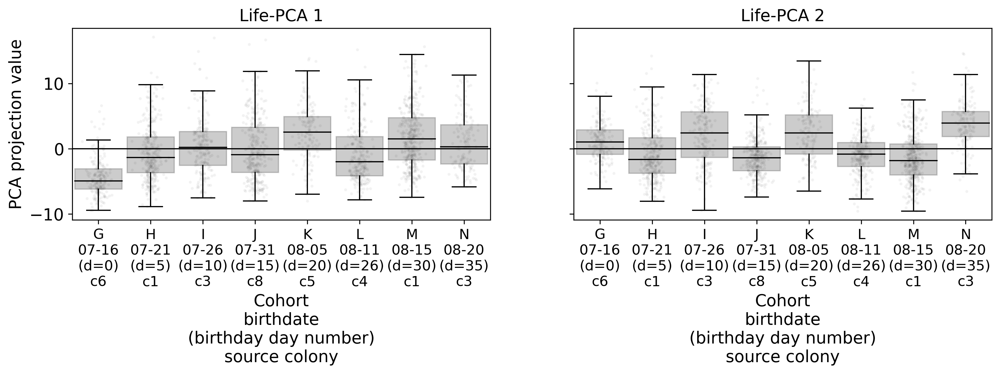

In [37]:
ucids = np.unique(bee_cohortids)
numcohorts = len(ucids)


f,ax = plt.subplots(1,2,sharex=True,sharey=True)
f.set_size_inches(14,3)
f.set_dpi(300)
a = ax
bp.quantitydists(numcohorts,bee_cohortids-np.min(bee_cohortids),ubeelife[:,0:2].T,
                 ['Life-PCA 1','Life-PCA 2'],
              f=f,ax=ax,coloroffset=1000,)#color=np.array(bd.cohort_colors)[ucids])
# ax[0].set_ylim([min_dayobs-1,50])

labels = [bd.cohort_names[j][0].upper()+'\n'+bp.showmonthday(bd.cohort_birthdates[j])+'\n(d='+str((bd.cohort_birthdates[j] - bd.alldaytimestamps[0]).days)+')\n'+bd.cohort_colonynames[j] for j in ucids]


for a in ax:
    a.set_xticks(range(numcohorts))
    a.set_xticklabels(labels,fontsize=12)
    a.set_xlabel('Cohort\nbirthdate\n(birthday day number)\nsource colony',fontsize=14)
ax[0].set_ylabel('PCA projection value',fontsize=14)
pdf.savefig(f) if savefigures else None
plt.show()

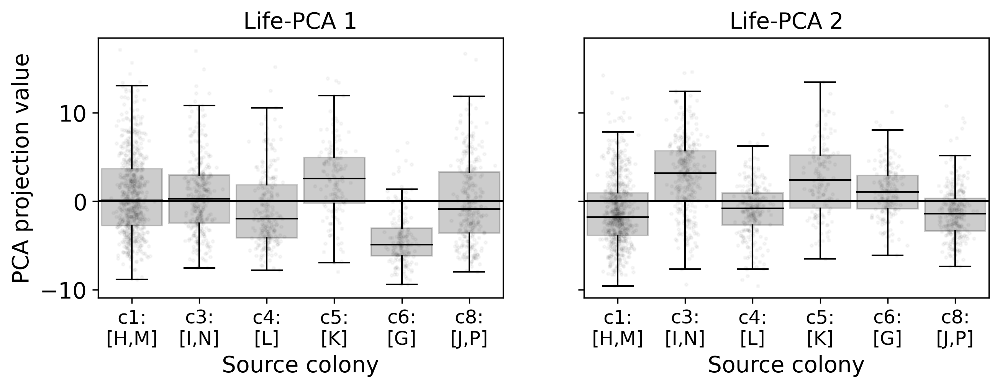

In [38]:
bee_colonynames_integer = bee_colonynames.copy()
for i in range(n_sourcecol):
    bee_colonynames_integer[bee_colonynames_integer==combined_unique[i]] = i
bee_colonynames_integer = bee_colonynames_integer.astype(int)

numsourcecols = len(combined_unique)

f,ax = plt.subplots(1,2,sharex=True,sharey=True)
f.set_size_inches(10,3)
f.set_dpi(300)
a = ax
bp.quantitydists(numsourcecols,bee_colonynames_integer,ubeelife[:,0:2].T,['Life-PCA 1','Life-PCA 2'],
              f=f,ax=ax,coloroffset=1000,pointskip=1)
# ax[0].set_ylim([min_dayobs-1,50])

labels = [c+':\n'+'['+','.join([bd.cohort_names[j][0].upper() for j in np.where((bd.cohort_colonynames == c)&(np.arange(bd.numcohorts)>=ucids[0]))[0]])+']' for c in combined_unique]

for a in ax:
    a.set_xticks(range(numsourcecols))
    a.set_xticklabels(labels,fontsize=12)
    a.set_xlabel('Source colony',fontsize=14)
ax[0].set_ylabel('PCA projection value',fontsize=14)
pdf.savefig(f) if savefigures else None
plt.show()

### CLOSE FIGURE SAVING

In [39]:
pdf.close() if savefigures else None
savefigures=False